## Imports

In [61]:
import warnings
import os
import zipfile
import tensorflow as tf
from sklearn.metrics import average_precision_score

from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Conv2D, UpSampling2D, Concatenate, Input
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import matplotlib.pyplot as plt
import numpy as np

from PIL import Image 
from collections import Counter
import random

from sklearn.model_selection import train_test_split
from IPython.display import clear_output

import torch
import torchvision
from torchvision import transforms
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torch.utils.data import DataLoader
from torchvision.transforms import functional as F

# from torchvision.ops import box_iou
from torchvision.models.detection.faster_rcnn import FasterRCNN
from torchmetrics.detection.mean_ap import MeanAveragePrecision
from tqdm import tqdm  
from collections import defaultdict


from torchvision.models.detection import ssd300_vgg16, SSD300_VGG16_Weights, _utils
from torchvision.models.detection.ssd import SSDClassificationHead
from torchvision.models.detection.anchor_utils import AnchorGenerator
from torchvision.models.detection._utils import retrieve_out_channels
from torch.optim import AdamW


## Constants

In [62]:
url = "https://sid.erda.dk/public/archives/ff17dc924eba88d5d01a807357d6614c/FullIJCNN2013.zip"
filename = "FullIJCNN2013.zip"

data_dir = '/kaggle/working/FullIJCNN2013/FullIJCNN2013'
gt_file = '/kaggle/working/FullIJCNN2013/FullIJCNN2013/gt.txt'

annotations_file = "/kaggle/working/FullIJCNN2013/FullIJCNN2013/gt.txt"
images_dir       = "/kaggle/working/FullIJCNN2013/FullIJCNN2013"

CLASS_COUNT = 5

CLASS_TO_CATEGORY = {
    1: "prohibitory",
    2: "danger",
    3: "mandatory",
    4: "other"
}

class_mapping = {
    0: "speed limit 20 (prohibitory)",
    1: "speed limit 30 (prohibitory)",
    2: "speed limit 50 (prohibitory)",
    3: "speed limit 60 (prohibitory)",
    4: "speed limit 70 (prohibitory)",
    5: "speed limit 80 (prohibitory)",
    6: "restriction ends 80 (other)",
    7: "speed limit 100 (prohibitory)",
    8: "speed limit 120 (prohibitory)",
    9: "no overtaking (prohibitory)",
    10: "no overtaking (trucks) (prohibitory)",
    11: "priority at next intersection (danger)",
    12: "priority road (other)",
    13: "give way (other)",
    14: "stop (other)",
    15: "no traffic both ways (prohibitory)",
    16: "no trucks (prohibitory)",
    17: "no entry (other)",
    18: "danger (danger)",
    19: "bend left (danger)",
    20: "bend right (danger)",
    21: "bend (danger)",
    22: "uneven road (danger)",
    23: "slippery road (danger)",
    24: "road narrows (danger)",
    25: "construction (danger)",
    26: "traffic signal (danger)",
    27: "pedestrian crossing (danger)",
    28: "school crossing (danger)",
    29: "cycles crossing (danger)",
    30: "snow (danger)",
    31: "animals (danger)",
    32: "restriction ends (other)",
    33: "go right (mandatory)",
    34: "go left (mandatory)",
    35: "go straight (mandatory)",
    36: "go right or straight (mandatory)",
    37: "go left or straight (mandatory)",
    38: "keep right (mandatory)",
    39: "keep left (mandatory)",
    40: "roundabout (mandatory)",
    41: "restriction ends (overtaking) (other)",
    42: "restriction ends (overtaking (trucks)) (other)"
}

IOU_THRESHOLDS = np.arange(0.5, 1.0, 0.05)

## Plot Functions

In [ ]:
def get_size_group(width):
    if width < 32:
        return "small"
    elif 32 <= width <= 45:
        return "medium"
    else:
        return "large"  

def classify_bbox_sizes_and_classes(dataset):
    small = {"prohibitory": 0, "mandatory": 0, "danger": 0, "other": 0} 
    medium = {"prohibitory": 0, "mandatory": 0, "danger": 0, "other": 0} 
    large = {"prohibitory": 0, "mandatory": 0, "danger": 0, "other": 0} 

    for _, target in dataset:
        boxes = target["boxes"]
        labels = target["labels"]

        for box, label in zip(boxes, labels):
            size_group = get_size_group(width = box[2] - box[0])
            major_category = CLASS_TO_CATEGORY.get(label.item(), "other")

            if size_group == "small":
                small[major_category] += 1

            elif size_group == "medium":
                medium[major_category] += 1

            elif size_group == "large":
                large[major_category] += 1

    return { "small": small, "medium": medium, "large": large }   
    
def plot_annotations(image_path, annotations, image_number):
    image = Image.open(image_path)
    plt.imshow(image)
    plt.axis('off')

    plt.title(f"Image: {image_number}")

    for annotation in annotations:
        left, top, right, bottom, class_id = annotation
        class_name = class_mapping.get(class_id, "Unknown class")
        rect = plt.Rectangle((left, top), right-left, bottom-top, edgecolor='red', facecolor='none', linewidth=1)
        plt.gca().add_patch(rect)
        plt.text(left, top-20, class_name, color='red', fontsize=8, backgroundcolor='white', bbox=dict(facecolor='white', edgecolor='none', alpha=0.7))

    plt.show()

def plot_samples(data_dir, gt_file, sample_count):
    annotations = load_annotations(gt_file)
    img_files = sorted([f for f in os.listdir(data_dir) if f.endswith('.ppm')])

    random.shuffle(img_files)
    selected_files = img_files[:sample_count]

    for img_file in selected_files:
        img_path = os.path.join(data_dir, img_file)
        image_number = img_file.split('.')[0]
        if img_file in annotations:
            plot_annotations(img_path, annotations[img_file], image_number)

def plot_bar_chart(categories, counts, title, xlabel, ylabel, group_labels=None, bar_width=0.2, legend_labels=None):
    plt.figure(figsize=(10, 6))

    if group_labels:
        x = np.arange(len(categories))
        for i, group in enumerate(group_labels):
            plt.bar(x + i * bar_width, counts[i], bar_width, label=group)
        plt.xticks(x + bar_width * (len(group_labels) - 1) / 2, categories)
    else:
        plt.bar(categories, counts, color=['blue', 'orange', 'green'])

    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)

    if legend_labels:
        plt.legend(title="Class Group")

    plt.grid(axis="y", linestyle="--", alpha=0.7)
    plt.tight_layout()
    plt.show()

def plot_histogram(object_sizes):
    categories = list(object_sizes.keys())
    counts = list(object_sizes.values())
    plot_bar_chart(categories, counts, 
                   title="Object Size Distribution", 
                   xlabel="Object Size", 
                   ylabel="Count")

def plot_class_distribution(size_category_counts):
    size_groups = ["small", "medium", "large"]
    categories = ["prohibitory", "mandatory", "danger", "other"]
    bar_data = [[size_category_counts[size][cat] for size in size_groups] for cat in categories]

    plot_bar_chart(size_groups, bar_data, 
                   title="Class Distribution by Size Category", 
                   xlabel="Size Category", 
                   ylabel="Frequency", 
                   group_labels=categories, 
                   bar_width=0.2, 
                   legend_labels=categories)

def plot_class_histogram(data, title, xlabel, ylabel, color='purple'):
    categories = list(data.keys())
    counts = list(data.values())

    plt.figure(figsize=(12, 8)) 
    plt.barh(categories, counts, color=color, height=0.8)
    plt.xlabel(ylabel)  
    plt.ylabel(xlabel)
    plt.title(title)
    plt.gca().invert_yaxis()
    plt.show()

def plot_map_results(map_results):
    ap_per_class = {class_id: [] for class_id in CLASS_TO_CATEGORY.keys() if class_id != 0}

    for iou in IOU_THRESHOLDS:
        for class_id, ap in map_results[iou]['AP_per_class'].items():
            if class_id != 0:  
                ap_per_class[class_id].append(ap)

    mAP_values = [map_results[iou]['mAP'] for iou in IOU_THRESHOLDS]

    plt.figure(figsize=(10, 6))

    for class_id, ap_values in ap_per_class.items():
        label = CLASS_TO_CATEGORY.get(class_id, f"Unknown ({class_id})")
        plt.plot(
            IOU_THRESHOLDS, ap_values, label=f"{label} AP", linestyle='--', marker='o'
        )

    plt.plot(
        IOU_THRESHOLDS, mAP_values, label="mAP", linestyle='-', marker='x', color='black'
    )

    plt.axvline(x=0.7, color='purple', linestyle='--', label='IoU = 0.7')

    plt.title("AP and mAP Across IoU Thresholds", fontsize=14)
    plt.xlabel("Intersection over Union (IoU)", fontsize=12)
    plt.ylabel("Average Precision (AP)", fontsize=12)
    plt.legend(fontsize=10)
    plt.grid(True, linestyle="--", alpha=0.7)
    plt.show()


## Utility functions

In [64]:
def get_class_value(class_number):
    return class_mapping.get(class_number, "Unknown class number")

def load_annotations(gt_file):
    annotations = {}
    with open(gt_file, 'r') as file:
        lines = file.readlines()
        for line in lines:
            parts = line.strip().split(';')
            img_file = parts[0]
            left, top, right, bottom, class_id = map(int, parts[1:])
            if img_file not in annotations:
                annotations[img_file] = []
            annotations[img_file].append((left, top, right, bottom, class_id))
    return annotations

def categorize_objects(annotations):
    object_sizes = {'small': 0, 'medium': 0, 'large': 0}
    for img_file, objs in annotations.items():
        for obj in objs:
            left, top, right, bottom, class_id = obj
            width = right - left
            if width < 32:
                object_sizes['small'] += 1
            elif 32 <= width and width < 45:
                object_sizes['medium'] += 1
            else:
                object_sizes['large'] += 1
    return object_sizes

def count_objects_by_class(annotations):
    class_counts = Counter()
    for img_file, objs in annotations.items():
        for obj in objs:
            class_id = obj[4]
            class_name = class_mapping.get(class_id, "Unknown class")
            class_counts[class_name] += 1
    return class_counts

def collate_fn(batch):
    return tuple(zip(*batch))

def split_dataset(dataset, val_ratio=0.1, test_ratio=0.2, random_state=123):
    indices = list(range(len(dataset)))
    temp_indices, test_indices = train_test_split(indices, test_size=test_ratio, random_state=random_state)
    train_indices, val_indices = train_test_split(temp_indices, test_size=val_ratio, random_state=random_state)
    
    train_dataset = Subset(dataset, train_indices)
    val_dataset   = Subset(dataset, val_indices)
    test_dataset  = Subset(dataset, test_indices)
    return train_dataset, val_dataset, test_dataset

def get_datasets(dataset):
    train_dataset, val_dataset, test_dataset = split_dataset(dataset, val_ratio=0.1, test_ratio=0.2)
    print(f'Size of Dataset: {len(dataset)}')
    print(f'------------------------------')
    print(f'Size of Train Dataset:      {len(train_dataset)}')
    print(f'Size of Test Dataset:       {len(val_dataset)}')
    print(f'Size of Validation Dataset: {len(test_dataset)}')
    return train_dataset, val_dataset, test_dataset

def get_dataloader(dataset, shuffle, batch_size=4):
    return DataLoader(dataset, batch_size=batch_size, shuffle=True, collate_fn=collate_fn)

def get_model(num_classes):
    model = fasterrcnn_resnet50_fpn(weights="COCO_V1")
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(
        in_features, num_classes
    )
    return model

## Model Functions

### FRCNN

In [65]:
IOU_METRIC = 0
MAP_METRIC = 1
def train_faster_rcnn_staged(model, train_loader, val_loader, device, rpn_epochs, roi_epochs, 
                             fine_tune_epochs, rpn_patience=4, roi_patience=4, fine_tune_patience=4, lr=1e-3, fine_tuning_lr=3e-5):
    print("Starting staged training...")
    first_roi_ious = []
    rpn_ious = []
    second_roi_maps = []
    final_finetuning = []
    # Stage: Train ROI Head
    for param in model.backbone.parameters():
        param.requires_grad = False
    for param in model.roi_heads.parameters():
        param.requires_grad = True
    for param in model.rpn.parameters():
        param.requires_grad = False
    optimizer = torch.optim.AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr)
    model, first_roi_ious = run_stage(model, train_loader, val_loader, optimizer, roi_epochs, roi_patience, "ROI Head", IOU_METRIC)
    
    # Stage: Train RPN
    for param in model.backbone.parameters():
        param.requires_grad = False
    for param in model.roi_heads.parameters():
        param.requires_grad = False
    for param in model.rpn.parameters():
        param.requires_grad = True
    optimizer = torch.optim.AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr)
    model, rpn_ious = run_stage(model, train_loader, val_loader, optimizer, rpn_epochs, rpn_patience, "RPN", IOU_METRIC)
    
    # Stage: Train ROI Head
    for param in model.backbone.parameters():
        param.requires_grad = False
    for param in model.roi_heads.parameters():
        param.requires_grad = True
    for param in model.rpn.parameters():
        param.requires_grad = False
    optimizer = torch.optim.AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr)
    model, second_roi_maps = run_stage(model, train_loader, val_loader, optimizer, roi_epochs, roi_patience, "ROI Head", MAP_METRIC)
    
    # Stage: Fine-tune Entire Network
    for param in model.parameters():
        param.requires_grad = True
    optimizer = torch.optim.AdamW(model.parameters(), lr=fine_tuning_lr)
    model, final_finetuning = run_stage(model, train_loader, val_loader, optimizer, fine_tune_epochs, fine_tune_patience, "Fine-tuning", MAP_METRIC)

    print("Staged training complete.")
    return model, first_roi_ious, rpn_ious, second_roi_maps, final_finetuning

### SSD

In [40]:
def create_ssd_model(num_classes=5, size=300):
    model = torchvision.models.detection.ssd300_vgg16(weights=SSD300_VGG16_Weights.DEFAULT)
    in_channels = _utils.retrieve_out_channels(model.backbone, (size, size))
    num_anchors = model.anchor_generator.num_anchors_per_location()
    model.head.classification_head = SSDClassificationHead(
        in_channels=in_channels, num_anchors=num_anchors, num_classes=num_classes)
    model.transform.min_size = (size,)
    model.transform.max_size = size
    return model

def train_ssd(model, train_loader, val_loader, device, epochs, patience, lr=1e-3):
    params = [p for p in model.parameters() if p.requires_grad]
    optimizer = AdamW(params, lr=lr)

    val_mAP_history = []
    map_half_hist = []
    best_model_weights = None
    best_mAP = 0.0

    for epoch in range(num_epochs):
        print(f"Epoch {epoch + 1}/{num_epochs}")
        model.train()
        running_loss = 0.0
        prog_bar = tqdm(train_loader, total=len(train_loader))

        for images, targets in prog_bar:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            optimizer.zero_grad()
            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())
            loss_value = losses.item()
            losses.backward()
            optimizer.step()
            running_loss += losses.item()
            prog_bar.set_description(desc=f"Loss: {loss_value:.4f}")

        print(f"Training Loss: {running_loss / len(train_loader):.4f}")

        # Validation and mAP calculation
        model.eval()
        with torch.no_grad():
            _, maps = calculate_map_multiclass(model, val_loader)
            val_mAP = maps[0.5]['mAP']
            val_mAP_history.append(maps)
            map_half_hist.append(val_mAP)
            print(f"Validation mAP: {val_mAP:.4f}")

            # Save best model weights
            if val_mAP > best_mAP:
                best_mAP = val_mAP
                best_model_weights = model.state_dict()
                print ("best model saved")

        # Early stopping
        if early_stop(map_half_hist, patience):
            print(f"Early stopping triggered at epoch {epoch + 1}")
            break

        # Step LR scheduler
        # lr_scheduler.step()

    # Load best model weights
    if best_model_weights:
        model.load_state_dict(best_model_weights)
        print("Best model weights restored.")

    return model, val_mAP_history

### Metrics

In [66]:
def box_iou(boxes1, boxes2):
    if boxes1.numel() == 0 or boxes2.numel() == 0:
        return torch.zeros((boxes1.size(0), boxes2.size(0)), device=boxes1.device)

    x1 = torch.max(boxes1[:, None, 0], boxes2[:, 0])  # Top-left x
    y1 = torch.max(boxes1[:, None, 1], boxes2[:, 1])  # Top-left y
    x2 = torch.min(boxes1[:, None, 2], boxes2[:, 2])  # Bottom-right x
    y2 = torch.min(boxes1[:, None, 3], boxes2[:, 3])  # Bottom-right y

    inter_width = (x2 - x1).clamp(min=0)
    inter_height = (y2 - y1).clamp(min=0)
    inter_area = inter_width * inter_height

    area1 = (boxes1[:, 2] - boxes1[:, 0]) * (boxes1[:, 3] - boxes1[:, 1])  # Area of boxes1
    area2 = (boxes2[:, 2] - boxes2[:, 0]) * (boxes2[:, 3] - boxes2[:, 1])  # Area of boxes2

    union_area = area1[:, None] + area2 - inter_area
    iou = inter_area / union_area

    return iou

def early_stop(metric_values, patience):
    if not metric_values: return False
    best_metric = max(metric_values)
    best_metric_epoch = len(metric_values) - 1 - metric_values[::-1].index(best_metric)
    if len(metric_values) - best_metric_epoch - 1 >= patience:
        recent_metrics = metric_values[best_metric_epoch + 1:]
        if all(m <= best_metric for m in recent_metrics[:patience]): return True
    return False

def compute_iou_loss(model, val_loader):
    model.eval()
    total_iou = 0
    total_samples = 0
    with torch.no_grad():
        for images, targets in val_loader:
            images = list(img.to(device) for img in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            
            outputs = model(images)
            
            for output, target in zip(outputs, targets):
                pred_boxes, target_boxes = output['boxes'], target['boxes']
                if pred_boxes.numel() == 0 or target_boxes.numel() == 0:
                    # print(f"Empty boxes found. Predicted: {pred_boxes.numel()}, Target: {target_boxes.numel()}")
                    continue
                
                ious = box_iou(pred_boxes, target_boxes)                   
                if ious.numel() == 0: 
                    # print(f"No valid IoUs found between predicted and target boxes.")
                    continue
                
                mean_iou = ious.mean().item()
                if torch.isnan(torch.tensor(mean_iou)):
                    # print(f"NaN IoU found. Predicted boxes: {pred_boxes}, Target boxes: {target_boxes}")
                    continue
                
                total_iou += mean_iou
                total_samples += 1
    
    if total_samples == 0:
        print("No valid samples found in validation set for IoU computation.")
        return float('nan')  
    
    return total_iou / total_samples

def run_stage(model, train_loader, val_loader, optimizer, num_epochs, patience, stage_name, eval_metric_fn):
    best_metric = 0
    metric_values = []
    temp_metric_values = []
    best_model_weights = None
    for epoch in range(num_epochs):
        print(f"\n{stage_name} Training - Epoch {epoch + 1}/{num_epochs}")
        model.train()
        epoch_loss = 0
        for images, targets in tqdm(train_loader, desc="Batch", leave=True, ncols=100):
            images = list(img.to(device) for img in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            loss_dict = model(images, targets)
            total_loss = sum(loss for loss in loss_dict.values())
            
            optimizer.zero_grad()
            total_loss.backward()
            optimizer.step()
            
            epoch_loss += total_loss.item()
        
        print(f"Epoch {epoch + 1}/{num_epochs} - Loss: {epoch_loss:.4f}")

        if (eval_metric_fn == IOU_METRIC):
            metric_value = compute_iou_loss(model, val_loader)
            metric_values.append(metric_value)
            temp_metric_values.append(metric_value)
        else:
            _, maps = calculate_map_multiclass(model, val_loader)
            metric_value = maps[0.5]['mAP']
            temp_metric_values.append(metric_value)
            metric_values.append(maps)
                    
        print(f"Validation Metric ({stage_name}): {metric_value}")
        
        if metric_value > best_metric:
            best_metric = metric_value
            torch.save(model.state_dict(), f"best_{stage_name.lower()}_model.pth")
            best_model_weights = model.state_dict()
            print(f"Best model for {stage_name} saved.")

        if early_stop(temp_metric_values, patience):
            print(f"Early stopping triggered for {stage_name}.")
            break

    if best_model_weights:
        model.load_state_dict(best_model_weights)
        print("Best model weights restored.")
    
    return model, metric_values

def test(model, loader):
    res = {}
    model.eval()
    with torch.no_grad():
        _, maps = calculate_map_multiclass(model, loader)
        res = maps

    return res

def calculate_map_multiclass(model, val_loader):
    model.eval()
    ap_scores_per_class = {iou: defaultdict(list) for iou in IOU_THRESHOLDS}

    with torch.no_grad():
        for images, targets in val_loader:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            outputs = model(images)

            for output, target in zip(outputs, targets):
                pred_boxes = output['boxes']
                pred_scores = output['scores']
                pred_labels = output['labels']
                target_boxes = target['boxes']
                target_labels = target['labels']
                
                if pred_boxes.numel() == 0 or target_boxes.numel() == 0:
                    continue

                # Sort predictions by confidence score
                sorted_indices = torch.argsort(pred_scores, descending=True)
                pred_boxes = pred_boxes[sorted_indices]
                pred_scores = pred_scores[sorted_indices]
                pred_labels = pred_labels[sorted_indices]

                for iou_threshold in IOU_THRESHOLDS:
                    for cls in range(1, CLASS_COUNT):
                        # Filter predictions and targets for the current class
                        cls_pred_boxes = pred_boxes[pred_labels == cls]
                        cls_pred_scores = pred_scores[pred_labels == cls]
                        cls_target_boxes = target_boxes[target_labels == cls]

                        if cls_pred_boxes.numel() == 0 and cls_target_boxes.numel() == 0:
                            continue

                        # Initialize True Positives (TP) and False Positives (FP)
                        tp = torch.zeros(len(cls_pred_boxes), dtype=torch.float32, device=device)
                        fp = torch.zeros(len(cls_pred_boxes), dtype=torch.float32, device=device)

                        if cls_target_boxes.numel() > 0:
                            matches = torch.zeros(len(cls_target_boxes), dtype=torch.bool, device=device)

                            for i, pred_box in enumerate(cls_pred_boxes):
                                
                                ious = box_iou(pred_box.unsqueeze(0), cls_target_boxes).squeeze(0)
                                max_iou, max_idx = torch.max(ious, dim=0)

                                if max_iou >= iou_threshold and not matches[max_idx]:
                                    tp[i] = 1
                                    matches[max_idx] = True
                                else:
                                    fp[i] = 1
                        else:
                            fp[:] = 1

                        # Calculate precision and recall
                        tp_cumsum = torch.cumsum(tp, dim=0)
                        fp_cumsum = torch.cumsum(fp, dim=0)
                        precisions = tp_cumsum / (tp_cumsum + fp_cumsum + 1e-6)
                        recalls = tp_cumsum / max(len(cls_target_boxes), 1)

                        # Append average precision score for the class
                        ap = compute_ap(precisions, recalls)
                        ap_scores_per_class[iou_threshold][cls].append(ap)

    # Compute AP per class and mAP for each IoU threshold
    map_results = {}
    for iou_threshold in IOU_THRESHOLDS:
        ap_per_class = {
            cls: torch.tensor(ap_scores_per_class[iou_threshold][cls]).mean().item() if ap_scores_per_class[iou_threshold][cls] else float('nan')
            for cls in range(1, CLASS_COUNT)
        }
        map_results[iou_threshold] = {
            'AP_per_class': ap_per_class,
            'mAP': sum(ap_per_class.values()) / (CLASS_COUNT - 1)
        }

    map_results['overall_mAP'] = sum(map_results[iou]['mAP'] for iou in IOU_THRESHOLDS) / len(IOU_THRESHOLDS)

    return map_results['overall_mAP'], map_results

def compute_ap(precisions, recalls):
    precisions = torch.cat([torch.tensor([0.], device=device), precisions, torch.tensor([0.], device=device)])
    recalls = torch.cat([torch.tensor([0.], device=device), recalls, torch.tensor([1.], device=device)])

    for i in range(precisions.size(0) - 1, 0, -1):
        precisions[i - 1] = torch.max(precisions[i - 1], precisions[i])

    indices = torch.where(recalls[1:] != recalls[:-1])[0]
    ap = torch.sum((recalls[indices + 1] - recalls[indices]) * precisions[indices + 1])
    return ap.item()



## Metric Functoins

## Load Dataset

In [8]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(device)

cuda


In [9]:
try:
    os.system(f"wget -O {filename} {url}")
    clear_output(wait=True)
    print(f"{filename} downloaded successfully.")
except Exception as e:
    print("An error occurred while downloading the dataset:", str(e))

FullIJCNN2013.zip downloaded successfully.


In [10]:
if os.path.exists(filename):
    try:
        with zipfile.ZipFile(filename, 'r') as zip_ref:
            zip_ref.extractall("FullIJCNN2013")  
        print(f"{filename} extracted successfully.")
    except Exception as e:
        print("An error occurred while extracting the dataset:", str(e))
else:
    print(f"{filename} not found for extraction.")

FullIJCNN2013.zip extracted successfully.


In [11]:
print(f"Class {CLASS_COUNT}: {get_class_value(CLASS_COUNT)}")

Class 5: speed limit 80 (prohibitory)


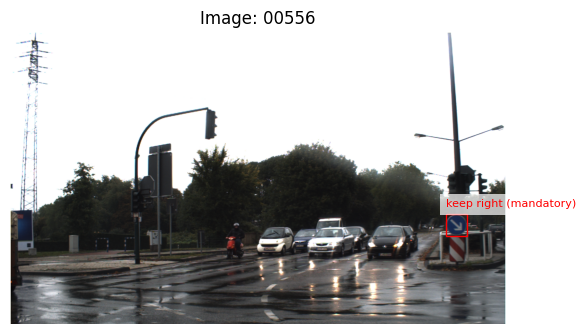

In [12]:
plot_samples(data_dir, gt_file, sample_count=3)

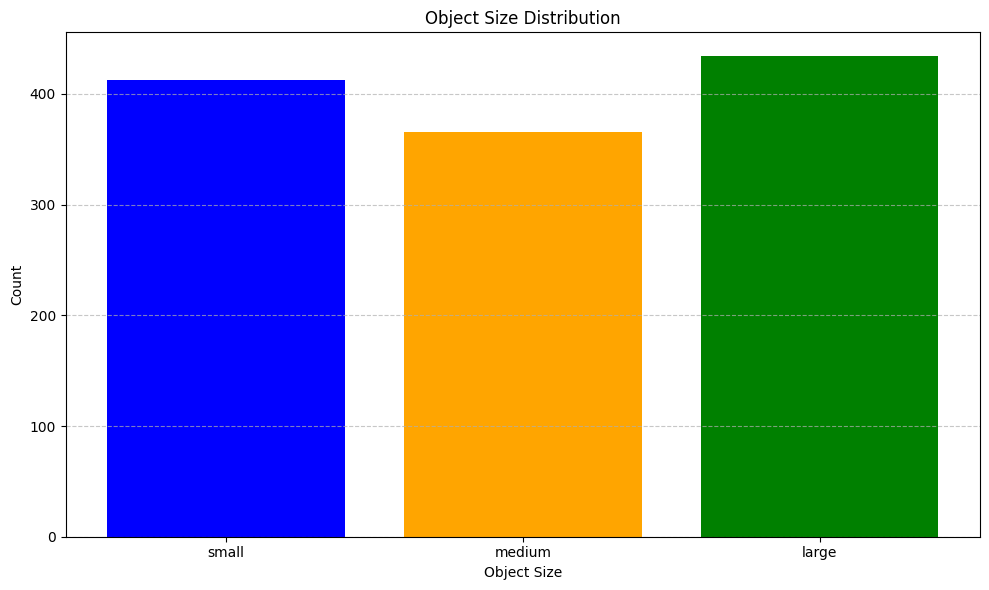

In [13]:
annotations = load_annotations(gt_file)
object_sizes = categorize_objects(annotations)
plot_histogram(object_sizes)

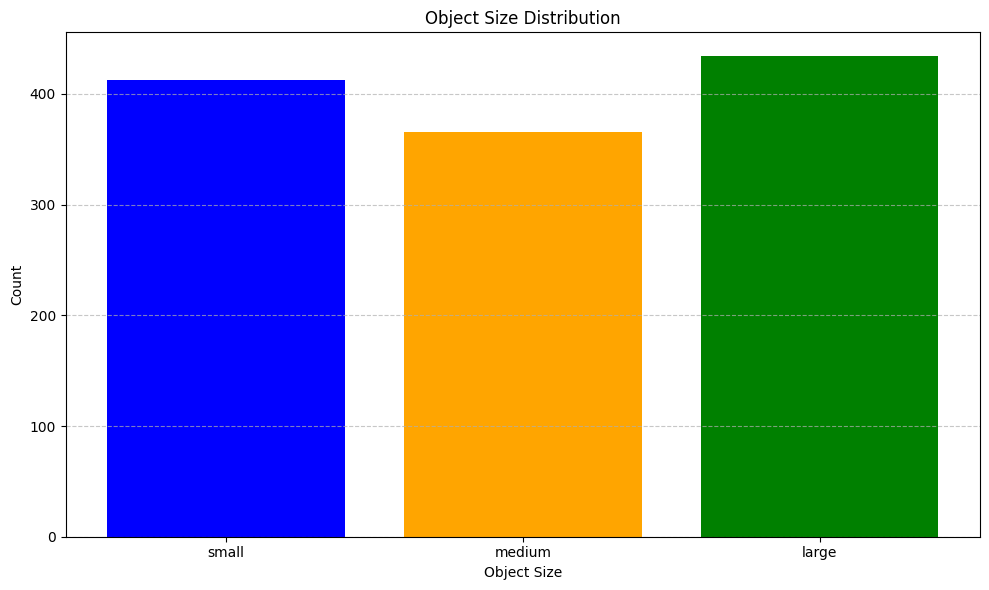

In [14]:
annotations = load_annotations(gt_file)
object_sizes = categorize_objects(annotations)
plot_histogram(object_sizes)

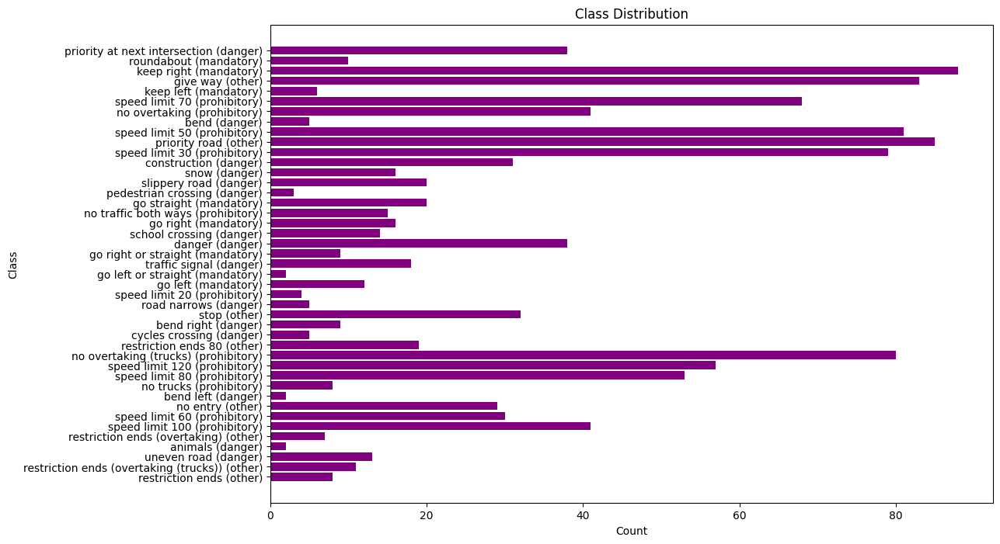

In [15]:
class_counts = count_objects_by_class(annotations)
plot_class_histogram(class_counts, "Class Distribution", "Class", "Count", color='purple')

## Dataset Class

In [16]:
from torch.utils.data import Dataset, Subset

class FullIJCNN2013Dataset(Dataset):
    def __init__(self, annotations_file, images_dir, transform=None):
        self.annotations = self._load_annotations(annotations_file)
        self.images_dir = images_dir
        self.transform = transform
        self.label_to_id = {
            "prohibitory": 1,
            "danger": 2,
            "mandatory": 3,
            "other": 4
        }

    def _load_annotations(self, annotations_file):
        category_mapping = {
            "prohibitory": list(range(0, 6)) + list(range(7, 11)) + [15, 16],
            "danger": list(range(18, 32)) + [11],
            "mandatory": list(range(33, 41)),
            "other": [6, 12, 13, 14, 17, 32, 41, 42]
        }

        category_lookup = {}
        for category, ids in category_mapping.items():
            for cid in ids:
                category_lookup[cid] = category

        annotations = {}
        with open(annotations_file, "r") as file:
            for line in file:
                parts = line.strip().split(";")
                img_name = parts[0]
                bbox = tuple(map(int, parts[1:5]))
                class_id = int(parts[5])
                category = category_lookup.get(class_id, "other")

                if img_name not in annotations:
                    annotations[img_name] = []
                annotations[img_name].append({"bbox": bbox, "label": category})
        return annotations

    def __len__(self):
        return len(self.annotations)

    def __getitem__(self, idx):
        img_name = list(self.annotations.keys())[idx]
        img_path = os.path.join(self.images_dir, img_name)
        image = Image.open(img_path).convert("RGB")

        objects = self.annotations[img_name]
        bboxes = torch.tensor([obj["bbox"] for obj in objects], dtype=torch.float32)
        labels = torch.tensor(
            [self.label_to_id[obj["label"]] for obj in objects], dtype=torch.int64
        )

        target = {
            "boxes": bboxes,
            "labels": labels
        }

        if self.transform: image = self.transform(image)

        return image, target

## Faser RCNN

In [67]:
transform = T.Compose([
    T.ToTensor(),
])

dataset = FullIJCNN2013Dataset(annotations_file, images_dir, transform=transform)

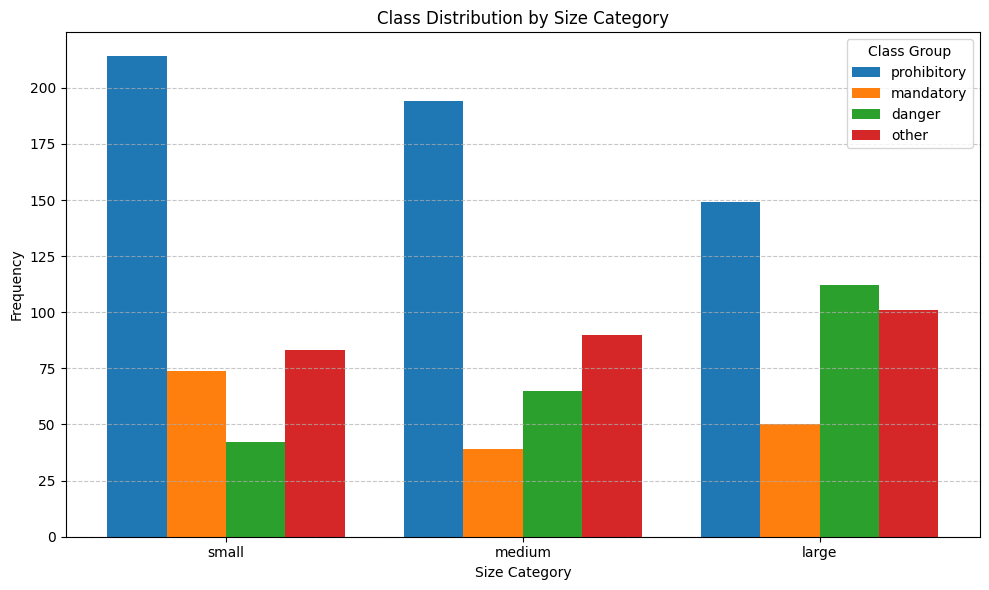

In [68]:
size_category_counts = classify_bbox_sizes_and_classes(dataset)
plot_class_distribution(size_category_counts)

In [69]:
train_dataset, val_dataset, test_dataset = get_datasets(dataset)

Size of Dataset: 741
------------------------------
Size of Train Dataset:      532
Size of Test Dataset:       60
Size of Validation Dataset: 149


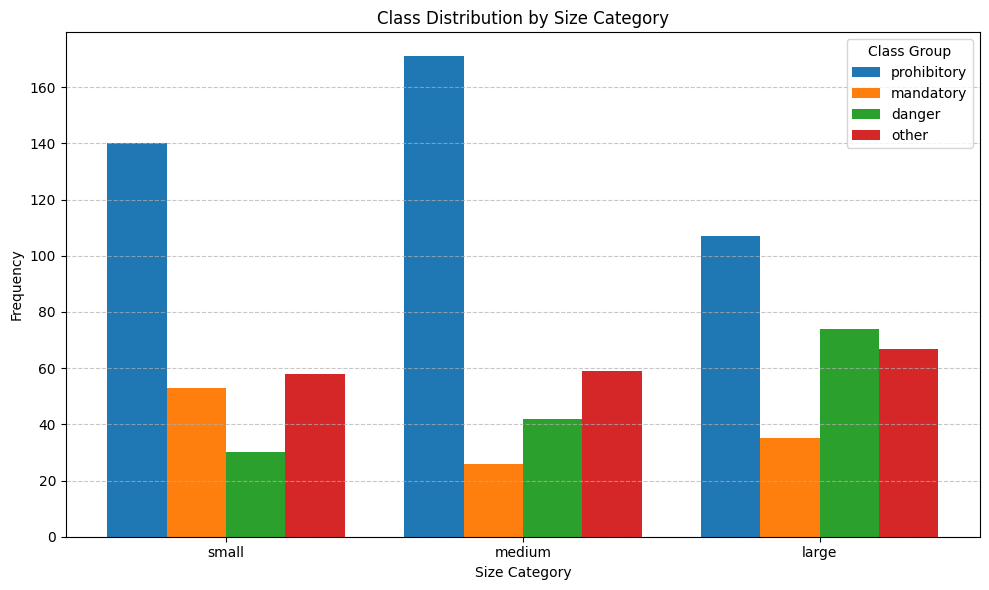

In [70]:
size_category_counts = classify_bbox_sizes_and_classes(train_dataset)
plot_class_distribution(size_category_counts)

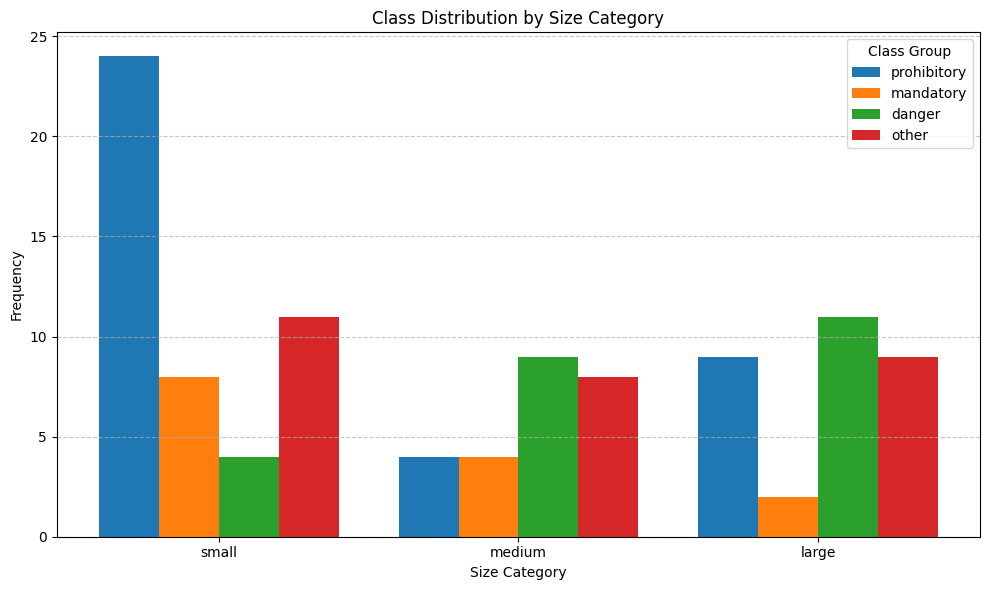

In [107]:
size_category_counts = classify_bbox_sizes_and_classes(val_dataset)
plot_class_distribution(size_category_counts)

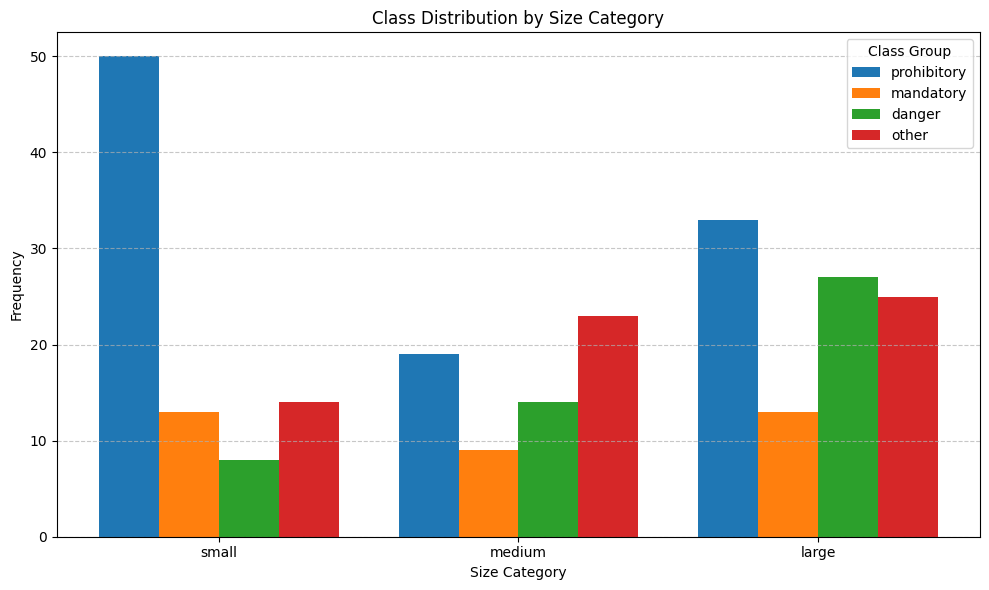

In [72]:
size_category_counts = classify_bbox_sizes_and_classes(test_dataset)
plot_class_distribution(size_category_counts)

In [73]:
train_loader = get_dataloader(train_dataset, True)
val_loader = get_dataloader(val_dataset, False)
test_loader = get_dataloader(test_dataset, False)

In [74]:
faster_rcnn_model = get_model(CLASS_COUNT).to(device)
model, first_roi_ious, rpn_ious, second_roi_maps, final_finetuning = train_faster_rcnn_staged(
    faster_rcnn_model, train_loader, val_loader, device, 
    rpn_epochs=100, roi_epochs=100, fine_tune_epochs=100,
    rpn_patience=7, roi_patience=7, fine_tune_patience=7,
    lr=3e-4
)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:00<00:00, 222MB/s] 


Starting staged training...

ROI Head Training - Epoch 1/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:43<00:00,  3.05it/s]


Epoch 1/100 - Loss: 20.2472
Validation Metric (ROI Head): 0.2712379981905727
Best model for ROI Head saved.

ROI Head Training - Epoch 2/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.91it/s]


Epoch 2/100 - Loss: 14.2204
Validation Metric (ROI Head): 0.3419993013927811
Best model for ROI Head saved.

ROI Head Training - Epoch 3/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 3/100 - Loss: 12.8233
Validation Metric (ROI Head): 0.38975693764431135
Best model for ROI Head saved.

ROI Head Training - Epoch 4/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.89it/s]


Epoch 4/100 - Loss: 12.1223
Validation Metric (ROI Head): 0.395996425966067
Best model for ROI Head saved.

ROI Head Training - Epoch 5/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 5/100 - Loss: 11.6881
Validation Metric (ROI Head): 0.4802102688010092
Best model for ROI Head saved.

ROI Head Training - Epoch 6/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 6/100 - Loss: 11.6092
Validation Metric (ROI Head): 0.4058256907896562

ROI Head Training - Epoch 7/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.89it/s]


Epoch 7/100 - Loss: 11.1848
Validation Metric (ROI Head): 0.5009901987494163
Best model for ROI Head saved.

ROI Head Training - Epoch 8/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.89it/s]


Epoch 8/100 - Loss: 11.1458
Validation Metric (ROI Head): 0.4598294816233895

ROI Head Training - Epoch 9/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 9/100 - Loss: 11.3441
Validation Metric (ROI Head): 0.48456357253922355

ROI Head Training - Epoch 10/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.92it/s]


Epoch 10/100 - Loss: 10.8796
Validation Metric (ROI Head): 0.5007013000969617

ROI Head Training - Epoch 11/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 11/100 - Loss: 10.3866
Validation Metric (ROI Head): 0.5449244377131646
Best model for ROI Head saved.

ROI Head Training - Epoch 12/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 12/100 - Loss: 10.4519
Validation Metric (ROI Head): 0.4687035942619497

ROI Head Training - Epoch 13/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 13/100 - Loss: 10.5306
Validation Metric (ROI Head): 0.5404053946148675

ROI Head Training - Epoch 14/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.89it/s]


Epoch 14/100 - Loss: 10.6437
Validation Metric (ROI Head): 0.5211909210906839

ROI Head Training - Epoch 15/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.89it/s]


Epoch 15/100 - Loss: 10.3931
Validation Metric (ROI Head): 0.5498708446438496
Best model for ROI Head saved.

ROI Head Training - Epoch 16/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.89it/s]


Epoch 16/100 - Loss: 10.4140
Validation Metric (ROI Head): 0.4649411938407204

ROI Head Training - Epoch 17/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.89it/s]


Epoch 17/100 - Loss: 10.3429
Validation Metric (ROI Head): 0.4969189976746181

ROI Head Training - Epoch 18/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 18/100 - Loss: 10.1094
Validation Metric (ROI Head): 0.5524997470470575
Best model for ROI Head saved.

ROI Head Training - Epoch 19/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.89it/s]


Epoch 19/100 - Loss: 10.2817
Validation Metric (ROI Head): 0.5721634634985373
Best model for ROI Head saved.

ROI Head Training - Epoch 20/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 20/100 - Loss: 10.0074
Validation Metric (ROI Head): 0.5145413472696587

ROI Head Training - Epoch 21/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 21/100 - Loss: 10.2135
Validation Metric (ROI Head): 0.5267998998363813

ROI Head Training - Epoch 22/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 22/100 - Loss: 10.2223
Validation Metric (ROI Head): 0.5318879518244002

ROI Head Training - Epoch 23/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.89it/s]


Epoch 23/100 - Loss: 10.2111
Validation Metric (ROI Head): 0.5732157142723308
Best model for ROI Head saved.

ROI Head Training - Epoch 24/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.87it/s]


Epoch 24/100 - Loss: 9.9573
Validation Metric (ROI Head): 0.5605156016799638

ROI Head Training - Epoch 25/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 25/100 - Loss: 10.0217
Validation Metric (ROI Head): 0.5610676851983254

ROI Head Training - Epoch 26/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 26/100 - Loss: 9.8764
Validation Metric (ROI Head): 0.5531807443443334

ROI Head Training - Epoch 27/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 27/100 - Loss: 10.1070
Validation Metric (ROI Head): 0.5689396030054643

ROI Head Training - Epoch 28/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 28/100 - Loss: 9.9697
Validation Metric (ROI Head): 0.5308691729914468

ROI Head Training - Epoch 29/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.89it/s]


Epoch 29/100 - Loss: 10.0242
Validation Metric (ROI Head): 0.5785037496915231
Best model for ROI Head saved.

ROI Head Training - Epoch 30/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 30/100 - Loss: 10.3384
Validation Metric (ROI Head): 0.5395959884209452

ROI Head Training - Epoch 31/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.89it/s]


Epoch 31/100 - Loss: 9.8794
Validation Metric (ROI Head): 0.5331146129459705

ROI Head Training - Epoch 32/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.89it/s]


Epoch 32/100 - Loss: 9.8804
Validation Metric (ROI Head): 0.5609165384219243

ROI Head Training - Epoch 33/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 33/100 - Loss: 9.9056
Validation Metric (ROI Head): 0.544692834128033

ROI Head Training - Epoch 34/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 34/100 - Loss: 9.5701
Validation Metric (ROI Head): 0.5423219152368032

ROI Head Training - Epoch 35/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 35/100 - Loss: 9.5854
Validation Metric (ROI Head): 0.5795977923732537
Best model for ROI Head saved.

ROI Head Training - Epoch 36/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.89it/s]


Epoch 36/100 - Loss: 9.7645
Validation Metric (ROI Head): 0.5480346395721976

ROI Head Training - Epoch 37/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.89it/s]


Epoch 37/100 - Loss: 9.6400
Validation Metric (ROI Head): 0.5239575966349188

ROI Head Training - Epoch 38/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 38/100 - Loss: 9.7282
Validation Metric (ROI Head): 0.587269609173139
Best model for ROI Head saved.

ROI Head Training - Epoch 39/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.89it/s]


Epoch 39/100 - Loss: 9.6694
Validation Metric (ROI Head): 0.58947601255316
Best model for ROI Head saved.

ROI Head Training - Epoch 40/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.89it/s]


Epoch 40/100 - Loss: 9.6677
Validation Metric (ROI Head): 0.5410573996749579

ROI Head Training - Epoch 41/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.89it/s]


Epoch 41/100 - Loss: 9.6710
Validation Metric (ROI Head): 0.5656436198162582

ROI Head Training - Epoch 42/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 42/100 - Loss: 9.4663
Validation Metric (ROI Head): 0.55067297016029

ROI Head Training - Epoch 43/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.87it/s]


Epoch 43/100 - Loss: 9.7858
Validation Metric (ROI Head): 0.5612208341749815

ROI Head Training - Epoch 44/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 44/100 - Loss: 9.5984
Validation Metric (ROI Head): 0.4881542237862101

ROI Head Training - Epoch 45/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 45/100 - Loss: 9.6630
Validation Metric (ROI Head): 0.5736805515793654

ROI Head Training - Epoch 46/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 46/100 - Loss: 9.5044
Validation Metric (ROI Head): 0.5587164756770318
Early stopping triggered for ROI Head.
Best model weights restored.

RPN Training - Epoch 1/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:49<00:00,  2.70it/s]


Epoch 1/100 - Loss: 13.1636
Validation Metric (RPN): 0.4615132411321004
Best model for RPN saved.

RPN Training - Epoch 2/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:49<00:00,  2.70it/s]


Epoch 2/100 - Loss: 13.5852
Validation Metric (RPN): 0.4605468213558197

RPN Training - Epoch 3/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:49<00:00,  2.70it/s]


Epoch 3/100 - Loss: 15.3859
Validation Metric (RPN): 0.4369939111173153

RPN Training - Epoch 4/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:49<00:00,  2.70it/s]


Epoch 4/100 - Loss: 14.7178
Validation Metric (RPN): 0.4339334093034267

RPN Training - Epoch 5/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:49<00:00,  2.68it/s]


Epoch 5/100 - Loss: 13.6590
Validation Metric (RPN): 0.43128656074404714

RPN Training - Epoch 6/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:49<00:00,  2.68it/s]


Epoch 6/100 - Loss: 14.2277
Validation Metric (RPN): 0.4473352633416653

RPN Training - Epoch 7/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:49<00:00,  2.68it/s]


Epoch 7/100 - Loss: 13.8517
Validation Metric (RPN): 0.438302680850029

RPN Training - Epoch 8/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:49<00:00,  2.68it/s]


Epoch 8/100 - Loss: 13.8638
Validation Metric (RPN): 0.4440063032011191
Early stopping triggered for RPN.
Best model weights restored.

ROI Head Training - Epoch 1/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:44<00:00,  2.96it/s]


Epoch 1/100 - Loss: 7.8905
Validation Metric (ROI Head): 0.3846041113138199
Best model for ROI Head saved.

ROI Head Training - Epoch 2/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.87it/s]


Epoch 2/100 - Loss: 5.9009
Validation Metric (ROI Head): 0.5296278893947601
Best model for ROI Head saved.

ROI Head Training - Epoch 3/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.86it/s]


Epoch 3/100 - Loss: 5.2609
Validation Metric (ROI Head): 0.5557864531874657
Best model for ROI Head saved.

ROI Head Training - Epoch 4/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.87it/s]


Epoch 4/100 - Loss: 4.8662
Validation Metric (ROI Head): 0.5886177942156792
Best model for ROI Head saved.

ROI Head Training - Epoch 5/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 5/100 - Loss: 4.4203
Validation Metric (ROI Head): 0.5822911933064461

ROI Head Training - Epoch 6/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:45<00:00,  2.90it/s]


Epoch 6/100 - Loss: 4.3638
Validation Metric (ROI Head): 0.624429389834404
Best model for ROI Head saved.

ROI Head Training - Epoch 7/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.89it/s]


Epoch 7/100 - Loss: 4.0915
Validation Metric (ROI Head): 0.6560205221176147
Best model for ROI Head saved.

ROI Head Training - Epoch 8/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 8/100 - Loss: 3.8736
Validation Metric (ROI Head): 0.5863824114203453

ROI Head Training - Epoch 9/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.86it/s]


Epoch 9/100 - Loss: 3.6921
Validation Metric (ROI Head): 0.7037467062473297
Best model for ROI Head saved.

ROI Head Training - Epoch 10/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 10/100 - Loss: 3.5436
Validation Metric (ROI Head): 0.6322076916694641

ROI Head Training - Epoch 11/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 11/100 - Loss: 3.3768
Validation Metric (ROI Head): 0.6477605253458023

ROI Head Training - Epoch 12/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 12/100 - Loss: 3.3619
Validation Metric (ROI Head): 0.6410250961780548

ROI Head Training - Epoch 13/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.89it/s]


Epoch 13/100 - Loss: 3.3608
Validation Metric (ROI Head): 0.5985333099961281

ROI Head Training - Epoch 14/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 14/100 - Loss: 3.1210
Validation Metric (ROI Head): 0.6934693604707718

ROI Head Training - Epoch 15/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 15/100 - Loss: 3.0660
Validation Metric (ROI Head): 0.6418813019990921

ROI Head Training - Epoch 16/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.89it/s]


Epoch 16/100 - Loss: 2.9200
Validation Metric (ROI Head): 0.7460935711860657
Best model for ROI Head saved.

ROI Head Training - Epoch 17/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.89it/s]


Epoch 17/100 - Loss: 2.7650
Validation Metric (ROI Head): 0.6422625407576561

ROI Head Training - Epoch 18/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 18/100 - Loss: 2.6522
Validation Metric (ROI Head): 0.6953332275152206

ROI Head Training - Epoch 19/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 19/100 - Loss: 2.6474
Validation Metric (ROI Head): 0.7289817333221436

ROI Head Training - Epoch 20/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.87it/s]


Epoch 20/100 - Loss: 2.5131
Validation Metric (ROI Head): 0.7120451778173447

ROI Head Training - Epoch 21/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 21/100 - Loss: 2.9017
Validation Metric (ROI Head): 0.68033067882061

ROI Head Training - Epoch 22/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.89it/s]


Epoch 22/100 - Loss: 2.6085
Validation Metric (ROI Head): 0.6095834225416183

ROI Head Training - Epoch 23/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [00:46<00:00,  2.88it/s]


Epoch 23/100 - Loss: 2.5498
Validation Metric (ROI Head): 0.6565041989088058
Early stopping triggered for ROI Head.
Best model weights restored.

Fine-tuning Training - Epoch 1/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 1/100 - Loss: 5.5364
Validation Metric (Fine-tuning): 0.5244942307472229
Best model for Fine-tuning saved.

Fine-tuning Training - Epoch 2/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 2/100 - Loss: 4.9356
Validation Metric (Fine-tuning): 0.6144835948944092
Best model for Fine-tuning saved.

Fine-tuning Training - Epoch 3/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.32it/s]


Epoch 3/100 - Loss: 4.0985
Validation Metric (Fine-tuning): 0.6559557467699051
Best model for Fine-tuning saved.

Fine-tuning Training - Epoch 4/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 4/100 - Loss: 3.6628
Validation Metric (Fine-tuning): 0.7167317569255829
Best model for Fine-tuning saved.

Fine-tuning Training - Epoch 5/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 5/100 - Loss: 3.2756
Validation Metric (Fine-tuning): 0.6891852468252182

Fine-tuning Training - Epoch 6/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.32it/s]


Epoch 6/100 - Loss: 2.9447
Validation Metric (Fine-tuning): 0.7332544177770615
Best model for Fine-tuning saved.

Fine-tuning Training - Epoch 7/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.32it/s]


Epoch 7/100 - Loss: 2.7113
Validation Metric (Fine-tuning): 0.7288966178894043

Fine-tuning Training - Epoch 8/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.32it/s]


Epoch 8/100 - Loss: 2.7299
Validation Metric (Fine-tuning): 0.7231610715389252

Fine-tuning Training - Epoch 9/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 9/100 - Loss: 2.4673
Validation Metric (Fine-tuning): 0.7445098161697388
Best model for Fine-tuning saved.

Fine-tuning Training - Epoch 10/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 10/100 - Loss: 2.6065
Validation Metric (Fine-tuning): 0.7210599929094315

Fine-tuning Training - Epoch 11/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 11/100 - Loss: 2.4219
Validation Metric (Fine-tuning): 0.7201172858476639

Fine-tuning Training - Epoch 12/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:39<00:00,  1.33it/s]


Epoch 12/100 - Loss: 2.2115
Validation Metric (Fine-tuning): 0.7320599406957626

Fine-tuning Training - Epoch 13/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 13/100 - Loss: 2.1219
Validation Metric (Fine-tuning): 0.7430217266082764

Fine-tuning Training - Epoch 14/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 14/100 - Loss: 2.0359
Validation Metric (Fine-tuning): 0.7713018655776978
Best model for Fine-tuning saved.

Fine-tuning Training - Epoch 15/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 15/100 - Loss: 1.9488
Validation Metric (Fine-tuning): 0.7341912984848022

Fine-tuning Training - Epoch 16/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 16/100 - Loss: 1.9364
Validation Metric (Fine-tuning): 0.7506733685731888

Fine-tuning Training - Epoch 17/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 17/100 - Loss: 2.0164
Validation Metric (Fine-tuning): 0.7882891595363617
Best model for Fine-tuning saved.

Fine-tuning Training - Epoch 18/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:39<00:00,  1.33it/s]


Epoch 18/100 - Loss: 1.9897
Validation Metric (Fine-tuning): 0.7878116816282272

Fine-tuning Training - Epoch 19/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 19/100 - Loss: 2.0143
Validation Metric (Fine-tuning): 0.7192228734493256

Fine-tuning Training - Epoch 20/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 20/100 - Loss: 1.9442
Validation Metric (Fine-tuning): 0.8183975666761398
Best model for Fine-tuning saved.

Fine-tuning Training - Epoch 21/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 21/100 - Loss: 1.8821
Validation Metric (Fine-tuning): 0.8273667395114899
Best model for Fine-tuning saved.

Fine-tuning Training - Epoch 22/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 22/100 - Loss: 1.8866
Validation Metric (Fine-tuning): 0.8233672231435776

Fine-tuning Training - Epoch 23/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:39<00:00,  1.33it/s]


Epoch 23/100 - Loss: 1.6808
Validation Metric (Fine-tuning): 0.8114979118108749

Fine-tuning Training - Epoch 24/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:39<00:00,  1.33it/s]


Epoch 24/100 - Loss: 1.6908
Validation Metric (Fine-tuning): 0.8572628498077393
Best model for Fine-tuning saved.

Fine-tuning Training - Epoch 25/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 25/100 - Loss: 1.5814
Validation Metric (Fine-tuning): 0.7786460965871811

Fine-tuning Training - Epoch 26/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 26/100 - Loss: 1.5592
Validation Metric (Fine-tuning): 0.7887813597917557

Fine-tuning Training - Epoch 27/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 27/100 - Loss: 1.7119
Validation Metric (Fine-tuning): 0.8167622983455658

Fine-tuning Training - Epoch 28/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 28/100 - Loss: 1.7242
Validation Metric (Fine-tuning): 0.8164227902889252

Fine-tuning Training - Epoch 29/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:39<00:00,  1.33it/s]


Epoch 29/100 - Loss: 1.6557
Validation Metric (Fine-tuning): 0.7739577144384384

Fine-tuning Training - Epoch 30/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:39<00:00,  1.33it/s]


Epoch 30/100 - Loss: 1.6478
Validation Metric (Fine-tuning): 0.870832622051239
Best model for Fine-tuning saved.

Fine-tuning Training - Epoch 31/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:39<00:00,  1.33it/s]


Epoch 31/100 - Loss: 1.6277
Validation Metric (Fine-tuning): 0.7990943044424057

Fine-tuning Training - Epoch 32/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 32/100 - Loss: 1.5845
Validation Metric (Fine-tuning): 0.8062167912721634

Fine-tuning Training - Epoch 33/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 33/100 - Loss: 1.4506
Validation Metric (Fine-tuning): 0.8673069924116135

Fine-tuning Training - Epoch 34/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 34/100 - Loss: 1.4942
Validation Metric (Fine-tuning): 0.8436757326126099

Fine-tuning Training - Epoch 35/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 35/100 - Loss: 1.4246
Validation Metric (Fine-tuning): 0.7625078707933426

Fine-tuning Training - Epoch 36/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:39<00:00,  1.33it/s]


Epoch 36/100 - Loss: 1.4607
Validation Metric (Fine-tuning): 0.8179531842470169

Fine-tuning Training - Epoch 37/100


Batch: 100%|██████████████████████████████████████████████████████| 133/133 [01:40<00:00,  1.33it/s]


Epoch 37/100 - Loss: 1.4529
Validation Metric (Fine-tuning): 0.8706115633249283
Early stopping triggered for Fine-tuning.
Best model weights restored.
Staged training complete.


In [ ]:
# stage_name = "Fine-tuning"
# faster_rcnn_model.load_state_dict(torch.load(f"best_{stage_name.lower()}_model.pth", weights_only=True))
# print("Evaluating...")

In [76]:
test_iou_loss = compute_iou_loss(model, test_loader)
print('IoU Loss: ', test_iou_loss)

IoU Loss:  0.6116587156617401


In [77]:
test_map_multiclass, map_results = calculate_map_multiclass(model, test_loader)
print('MAP of 0.5 IoU Threshold: ', map_results[0.5]["mAP"])

MAP of 0.5 IoU Threshold:  0.818099170923233


In [ ]:
# plot_map_results(map_results) # TODO fix this function

## SSD

In [19]:
transform = T.Compose([
    T.ToTensor(),
])

ssd_dataset = FullIJCNN2013Dataset(annotations_file, images_dir, transform=transform)

train_ssd_dataset, val_ssd_dataset, test_ssd_dataset = get_datasets(ssd_dataset)

ssd_train_loader = get_dataloader(train_ssd_dataset, True)
ssd_val_loader = get_dataloader(val_ssd_dataset, False)
ssd_test_loader = get_dataloader(test_ssd_dataset, False)

Size of Dataset: 741
------------------------------
Size of Train Dataset:      532
Size of Test Dataset:       60
Size of Validation Dataset: 149


In [20]:
ssd_model = create_ssd_model().to(device)
num_epochs = 40

for name, param in ssd_model.named_parameters():
    if "classification_head" not in name:
        param.requires_grad = False

In [21]:
ssd_model, ssd_head_training_res = train_ssd(ssd_model, ssd_train_loader, ssd_val_loader, device, num_epochs, 10, lr=3e-4)

Epoch 1/40


Loss: 5.5127: 100%|██████████| 133/133 [00:14<00:00,  9.16it/s]


Training Loss: 7.3562
Validation mAP: 0.0624
best model saved
Epoch 2/40


Loss: 4.1047: 100%|██████████| 133/133 [00:12<00:00, 10.66it/s]


Training Loss: 5.4774
Validation mAP: 0.0685
best model saved
Epoch 3/40


Loss: 5.3342: 100%|██████████| 133/133 [00:12<00:00, 11.05it/s]


Training Loss: 5.2344
Validation mAP: 0.0970
best model saved
Epoch 4/40


Loss: 4.2964: 100%|██████████| 133/133 [00:12<00:00, 10.94it/s] 


Training Loss: 5.1164
Validation mAP: 0.1039
best model saved
Epoch 5/40


Loss: 4.2945: 100%|██████████| 133/133 [00:11<00:00, 11.14it/s]


Training Loss: 5.0006
Validation mAP: 0.1025
Epoch 6/40


Loss: 5.9858: 100%|██████████| 133/133 [00:11<00:00, 11.09it/s]


Training Loss: 4.9401
Validation mAP: 0.1020
Epoch 7/40


Loss: 5.2379: 100%|██████████| 133/133 [00:12<00:00, 10.77it/s]


Training Loss: 4.8816
Validation mAP: 0.1007
Epoch 8/40


Loss: 5.7756: 100%|██████████| 133/133 [00:11<00:00, 11.09it/s]


Training Loss: 4.6862
Validation mAP: 0.1043
best model saved
Epoch 9/40


Loss: 3.8140: 100%|██████████| 133/133 [00:12<00:00, 10.85it/s]


Training Loss: 4.7077
Validation mAP: 0.1019
Epoch 10/40


Loss: 2.9243: 100%|██████████| 133/133 [00:12<00:00, 10.96it/s]


Training Loss: 4.5621
Validation mAP: 0.1081
best model saved
Epoch 11/40


Loss: 4.1180: 100%|██████████| 133/133 [00:12<00:00, 11.06it/s]


Training Loss: 4.5582
Validation mAP: 0.1090
best model saved
Epoch 12/40


Loss: 2.4784: 100%|██████████| 133/133 [00:12<00:00, 10.89it/s]


Training Loss: 4.5534
Validation mAP: 0.1023
Epoch 13/40


Loss: 5.6018: 100%|██████████| 133/133 [00:11<00:00, 11.16it/s]


Training Loss: 4.4859
Validation mAP: 0.1047
Epoch 14/40


Loss: 4.3611: 100%|██████████| 133/133 [00:12<00:00, 10.99it/s]


Training Loss: 4.4804
Validation mAP: 0.1043
Epoch 15/40


Loss: 4.0962: 100%|██████████| 133/133 [00:12<00:00, 10.94it/s]


Training Loss: 4.3878
Validation mAP: 0.1052
Epoch 16/40


Loss: 2.8203: 100%|██████████| 133/133 [00:11<00:00, 11.15it/s]


Training Loss: 4.3972
Validation mAP: 0.1093
best model saved
Epoch 17/40


Loss: 3.4703: 100%|██████████| 133/133 [00:12<00:00, 10.99it/s]


Training Loss: 4.2660
Validation mAP: 0.1109
best model saved
Epoch 18/40


Loss: 3.8220: 100%|██████████| 133/133 [00:12<00:00, 11.08it/s]


Training Loss: 4.2861
Validation mAP: 0.1184
best model saved
Epoch 19/40


Loss: 3.1674: 100%|██████████| 133/133 [00:12<00:00, 10.80it/s]


Training Loss: 4.2180
Validation mAP: 0.1092
Epoch 20/40


Loss: 4.9457: 100%|██████████| 133/133 [00:12<00:00, 10.98it/s]


Training Loss: 4.2124
Validation mAP: 0.1117
Epoch 21/40


Loss: 6.9303: 100%|██████████| 133/133 [00:12<00:00, 10.93it/s]


Training Loss: 4.1970
Validation mAP: 0.1124
Epoch 22/40


Loss: 2.5010: 100%|██████████| 133/133 [00:11<00:00, 11.14it/s]


Training Loss: 4.1232
Validation mAP: 0.1137
Epoch 23/40


Loss: 3.3510: 100%|██████████| 133/133 [00:12<00:00, 10.98it/s]


Training Loss: 4.1173
Validation mAP: 0.1130
Epoch 24/40


Loss: 2.9752: 100%|██████████| 133/133 [00:12<00:00, 11.00it/s]


Training Loss: 4.1489
Validation mAP: 0.1156
Epoch 25/40


Loss: 6.5390: 100%|██████████| 133/133 [00:12<00:00, 10.88it/s]


Training Loss: 4.1176
Validation mAP: 0.1205
best model saved
Epoch 26/40


Loss: 4.8336: 100%|██████████| 133/133 [00:12<00:00, 10.73it/s]


Training Loss: 4.0038
Validation mAP: 0.1238
best model saved
Epoch 27/40


Loss: 4.8695: 100%|██████████| 133/133 [00:12<00:00, 10.81it/s]


Training Loss: 4.0209
Validation mAP: 0.1191
Epoch 28/40


Loss: 2.9145: 100%|██████████| 133/133 [00:12<00:00, 10.86it/s]


Training Loss: 4.0099
Validation mAP: 0.1194
Epoch 29/40


Loss: 6.1886: 100%|██████████| 133/133 [00:12<00:00, 10.83it/s]


Training Loss: 3.9576
Validation mAP: 0.1210
Epoch 30/40


Loss: 5.4480: 100%|██████████| 133/133 [00:12<00:00, 10.96it/s]


Training Loss: 3.9648
Validation mAP: 0.1184
Epoch 31/40


Loss: 4.4081: 100%|██████████| 133/133 [00:12<00:00, 11.03it/s]


Training Loss: 3.9595
Validation mAP: 0.1188
Epoch 32/40


Loss: 2.3616: 100%|██████████| 133/133 [00:12<00:00, 10.94it/s]


Training Loss: 3.8972
Validation mAP: 0.1206
Epoch 33/40


Loss: 5.5996: 100%|██████████| 133/133 [00:12<00:00, 10.88it/s]


Training Loss: 3.8464
Validation mAP: 0.1204
Epoch 34/40


Loss: 3.7875: 100%|██████████| 133/133 [00:12<00:00, 10.78it/s]


Training Loss: 3.8290
Validation mAP: 0.1204
Epoch 35/40


Loss: 3.1435: 100%|██████████| 133/133 [00:12<00:00, 10.80it/s]


Training Loss: 3.8319
Validation mAP: 0.1192
Epoch 36/40


Loss: 3.4535: 100%|██████████| 133/133 [00:12<00:00, 10.87it/s]


Training Loss: 3.8190
Validation mAP: 0.1192
Early stopping triggered at epoch 36
Best model weights restored.


In [22]:
for param in ssd_model.parameters():
    param.requires_grad = True

In [23]:
ssd_model, ssd_first_fine_tuning_res = train_ssd(ssd_model, ssd_train_loader, ssd_val_loader, device, num_epochs, 10, lr=3e-4)

Epoch 1/40


Loss: 2.8143: 100%|██████████| 133/133 [00:20<00:00,  6.59it/s] 


Training Loss: 5.9841
Validation mAP: 0.1987
best model saved
Epoch 2/40


Loss: 1.9974: 100%|██████████| 133/133 [00:19<00:00,  6.71it/s]


Training Loss: 3.1682
Validation mAP: 0.2403
best model saved
Epoch 3/40


Loss: 3.5630: 100%|██████████| 133/133 [00:19<00:00,  6.66it/s]


Training Loss: 2.6976
Validation mAP: 0.3013
best model saved
Epoch 4/40


Loss: 2.3999: 100%|██████████| 133/133 [00:19<00:00,  6.73it/s]


Training Loss: 2.3840
Validation mAP: 0.2606
Epoch 5/40


Loss: 1.9493: 100%|██████████| 133/133 [00:20<00:00,  6.59it/s]


Training Loss: 2.2181
Validation mAP: 0.2653
Epoch 6/40


Loss: 1.6073: 100%|██████████| 133/133 [00:20<00:00,  6.65it/s] 


Training Loss: 2.2964
Validation mAP: 0.2459
Epoch 7/40


Loss: 1.2470: 100%|██████████| 133/133 [00:20<00:00,  6.64it/s]


Training Loss: 2.0452
Validation mAP: 0.2654
Epoch 8/40


Loss: 1.0285: 100%|██████████| 133/133 [00:20<00:00,  6.64it/s]


Training Loss: 1.7697
Validation mAP: 0.2636
Epoch 9/40


Loss: 0.8829: 100%|██████████| 133/133 [00:20<00:00,  6.60it/s]


Training Loss: 1.3618
Validation mAP: 0.2778
Epoch 10/40


Loss: 2.3321: 100%|██████████| 133/133 [00:19<00:00,  6.66it/s]


Training Loss: 1.1384
Validation mAP: 0.3241
best model saved
Epoch 11/40


Loss: 0.6546: 100%|██████████| 133/133 [00:19<00:00,  6.74it/s]


Training Loss: 0.8767
Validation mAP: 0.3542
best model saved
Epoch 12/40


Loss: 1.1904: 100%|██████████| 133/133 [00:19<00:00,  6.66it/s]


Training Loss: 0.7642
Validation mAP: 0.3284
Epoch 13/40


Loss: 0.2702: 100%|██████████| 133/133 [00:20<00:00,  6.65it/s]


Training Loss: 0.5779
Validation mAP: 0.3449
Epoch 14/40


Loss: 0.6413: 100%|██████████| 133/133 [00:19<00:00,  6.67it/s]


Training Loss: 0.4737
Validation mAP: 0.3743
best model saved
Epoch 15/40


Loss: 1.1929: 100%|██████████| 133/133 [00:20<00:00,  6.57it/s] 


Training Loss: 1.4354
Validation mAP: 0.2302
Epoch 16/40


Loss: 1.6414: 100%|██████████| 133/133 [00:20<00:00,  6.65it/s]


Training Loss: 1.0052
Validation mAP: 0.3651
Epoch 17/40


Loss: 0.2413: 100%|██████████| 133/133 [00:19<00:00,  6.70it/s]


Training Loss: 0.5504
Validation mAP: 0.4275
best model saved
Epoch 18/40


Loss: 1.1415: 100%|██████████| 133/133 [00:20<00:00,  6.64it/s]


Training Loss: 0.4773
Validation mAP: 0.3196
Epoch 19/40


Loss: 0.7194: 100%|██████████| 133/133 [00:20<00:00,  6.61it/s]


Training Loss: 0.7953
Validation mAP: 0.3403
Epoch 20/40


Loss: 0.3167: 100%|██████████| 133/133 [00:19<00:00,  6.67it/s]


Training Loss: 0.4376
Validation mAP: 0.5247
best model saved
Epoch 21/40


Loss: 0.1232: 100%|██████████| 133/133 [00:19<00:00,  6.70it/s]


Training Loss: 0.4303
Validation mAP: 0.4571
Epoch 22/40


Loss: 0.2579: 100%|██████████| 133/133 [00:19<00:00,  6.66it/s]


Training Loss: 0.2868
Validation mAP: 0.5749
best model saved
Epoch 23/40


Loss: 0.1980: 100%|██████████| 133/133 [00:19<00:00,  6.66it/s]


Training Loss: 0.1775
Validation mAP: 0.5793
best model saved
Epoch 24/40


Loss: 0.0365: 100%|██████████| 133/133 [00:20<00:00,  6.49it/s]


Training Loss: 0.1151
Validation mAP: 0.5850
best model saved
Epoch 25/40


Loss: 0.2460: 100%|██████████| 133/133 [00:20<00:00,  6.64it/s]


Training Loss: 0.0872
Validation mAP: 0.5837
Epoch 26/40


Loss: 0.0378: 100%|██████████| 133/133 [00:20<00:00,  6.60it/s]


Training Loss: 0.1049
Validation mAP: 0.5936
best model saved
Epoch 27/40


Loss: 0.0444: 100%|██████████| 133/133 [00:19<00:00,  6.65it/s]


Training Loss: 0.0939
Validation mAP: 0.6482
best model saved
Epoch 28/40


Loss: 0.0196: 100%|██████████| 133/133 [00:20<00:00,  6.64it/s]


Training Loss: 0.0763
Validation mAP: 0.6440
Epoch 29/40


Loss: 0.0178: 100%|██████████| 133/133 [00:20<00:00,  6.62it/s]


Training Loss: 0.0643
Validation mAP: 0.6649
best model saved
Epoch 30/40


Loss: 0.0273: 100%|██████████| 133/133 [00:19<00:00,  6.67it/s]


Training Loss: 0.0556
Validation mAP: 0.6680
best model saved
Epoch 31/40


Loss: 0.0245: 100%|██████████| 133/133 [00:20<00:00,  6.65it/s]


Training Loss: 0.0643
Validation mAP: 0.6539
Epoch 32/40


Loss: 0.0484: 100%|██████████| 133/133 [00:20<00:00,  6.62it/s]


Training Loss: 0.0672
Validation mAP: 0.6432
Epoch 33/40


Loss: 0.0878: 100%|██████████| 133/133 [00:19<00:00,  6.67it/s]


Training Loss: 0.0640
Validation mAP: 0.6842
best model saved
Epoch 34/40


Loss: 2.2291: 100%|██████████| 133/133 [00:20<00:00,  6.64it/s]


Training Loss: 1.0046
Validation mAP: 0.2140
Epoch 35/40


Loss: 1.1056: 100%|██████████| 133/133 [00:20<00:00,  6.62it/s]


Training Loss: 2.2611
Validation mAP: 0.3144
Epoch 36/40


Loss: 0.9429: 100%|██████████| 133/133 [00:20<00:00,  6.62it/s]


Training Loss: 1.0472
Validation mAP: 0.3305
Epoch 37/40


Loss: 1.9046: 100%|██████████| 133/133 [00:20<00:00,  6.64it/s]


Training Loss: 1.3035
Validation mAP: 0.2937
Epoch 38/40


Loss: 0.5144: 100%|██████████| 133/133 [00:20<00:00,  6.64it/s]


Training Loss: 1.6661
Validation mAP: 0.4339
Epoch 39/40


Loss: 0.4828: 100%|██████████| 133/133 [00:20<00:00,  6.57it/s]


Training Loss: 0.3976
Validation mAP: 0.5207
Epoch 40/40


Loss: 0.0990: 100%|██████████| 133/133 [00:20<00:00,  6.61it/s]


Training Loss: 0.2243
Validation mAP: 0.5472
Best model weights restored.


In [24]:
ssd_model, ssd_second_fine_tuning_res = train_ssd(ssd_model, ssd_train_loader, ssd_val_loader, device, num_epochs, 10, lr=3e-4)

Epoch 1/40


Loss: 0.2938: 100%|██████████| 133/133 [00:20<00:00,  6.63it/s]


Training Loss: 0.2070
Validation mAP: 0.5374
best model saved
Epoch 2/40


Loss: 1.7156: 100%|██████████| 133/133 [00:20<00:00,  6.62it/s] 


Training Loss: 0.6780
Validation mAP: 0.3123
Epoch 3/40


Loss: 0.4716: 100%|██████████| 133/133 [00:19<00:00,  6.74it/s] 


Training Loss: 0.6242
Validation mAP: 0.2982
Epoch 4/40


Loss: 0.3230: 100%|██████████| 133/133 [00:19<00:00,  6.69it/s]


Training Loss: 0.3593
Validation mAP: 0.5211
Epoch 5/40


Loss: 0.4357: 100%|██████████| 133/133 [00:20<00:00,  6.63it/s]


Training Loss: 0.1699
Validation mAP: 0.4966
Epoch 6/40


Loss: 0.0764: 100%|██████████| 133/133 [00:19<00:00,  6.69it/s]


Training Loss: 0.1239
Validation mAP: 0.4780
Epoch 7/40


Loss: 0.0406: 100%|██████████| 133/133 [00:20<00:00,  6.58it/s]


Training Loss: 0.1045
Validation mAP: 0.5741
best model saved
Epoch 8/40


Loss: 0.0398: 100%|██████████| 133/133 [00:20<00:00,  6.65it/s]


Training Loss: 0.0750
Validation mAP: 0.6187
best model saved
Epoch 9/40


Loss: 0.0329: 100%|██████████| 133/133 [00:19<00:00,  6.71it/s]


Training Loss: 0.0959
Validation mAP: 0.5952
Epoch 10/40


Loss: 0.0714: 100%|██████████| 133/133 [00:19<00:00,  6.73it/s]


Training Loss: 0.1064
Validation mAP: 0.6723
best model saved
Epoch 11/40


Loss: 0.1039: 100%|██████████| 133/133 [00:20<00:00,  6.60it/s]


Training Loss: 0.0766
Validation mAP: 0.6156
Epoch 12/40


Loss: 0.0705: 100%|██████████| 133/133 [00:19<00:00,  6.73it/s]


Training Loss: 0.0684
Validation mAP: 0.5837
Epoch 13/40


Loss: 0.1224: 100%|██████████| 133/133 [00:20<00:00,  6.61it/s]


Training Loss: 0.2533
Validation mAP: 0.5630
Epoch 14/40


Loss: 2.2319: 100%|██████████| 133/133 [00:20<00:00,  6.64it/s]


Training Loss: 0.4217
Validation mAP: 0.3673
Epoch 15/40


Loss: 0.4363: 100%|██████████| 133/133 [00:19<00:00,  6.67it/s]


Training Loss: 0.5016
Validation mAP: 0.5033
Epoch 16/40


Loss: 0.0832: 100%|██████████| 133/133 [00:19<00:00,  6.74it/s]


Training Loss: 0.4418
Validation mAP: 0.5187
Epoch 17/40


Loss: 0.5511: 100%|██████████| 133/133 [00:19<00:00,  6.72it/s]


Training Loss: 0.3136
Validation mAP: 0.4462
Epoch 18/40


Loss: 0.1480: 100%|██████████| 133/133 [00:19<00:00,  6.70it/s]


Training Loss: 0.2646
Validation mAP: 0.4981
Epoch 19/40


Loss: 0.0681: 100%|██████████| 133/133 [00:19<00:00,  6.66it/s]


Training Loss: 0.1842
Validation mAP: 0.5289
Epoch 20/40


Loss: 0.0170: 100%|██████████| 133/133 [00:20<00:00,  6.61it/s]


Training Loss: 0.0875
Validation mAP: 0.6239
Early stopping triggered at epoch 20
Best model weights restored.


In [45]:
result = test(ssd_model, ssd_test_loader)

In [46]:
result

{0.5: {'AP_per_class': {1: 0.6263730525970459,
   2: 0.6818175315856934,
   3: 0.5860210061073303,
   4: 0.486338347196579},
  'mAP': 0.5951374843716621},
 0.55: {'AP_per_class': {1: 0.6181313395500183,
   2: 0.6704539656639099,
   3: 0.5860210061073303,
   4: 0.486338347196579},
  'mAP': 0.5902361646294594},
 0.6000000000000001: {'AP_per_class': {1: 0.5989006161689758,
   2: 0.6704539656639099,
   3: 0.5860210061073303,
   4: 0.46994489431381226},
  'mAP': 0.5813301205635071},
 0.6500000000000001: {'AP_per_class': {1: 0.5824171304702759,
   2: 0.624999463558197,
   3: 0.5860210061073303,
   4: 0.4535515308380127},
  'mAP': 0.561747282743454},
 0.7000000000000002: {'AP_per_class': {1: 0.5467028617858887,
   2: 0.5852267742156982,
   3: 0.5860210061073303,
   4: 0.4330597221851349},
  'mAP': 0.537752591073513},
 0.7500000000000002: {'AP_per_class': {1: 0.5302193760871887,
   2: 0.57386314868927,
   3: 0.4892469048500061,
   4: 0.3469942510128021},
  'mAP': 0.48508092015981674},
 0.80000

In [106]:
ssd_test_iou_loss = compute_iou_loss(ssd_model, ssd_test_loader)
print('IoU Loss: ', ssd_test_iou_loss)
ssd_test_map_multiclass, ssd_map_results = calculate_map_multiclass(ssd_model, ssd_test_loader)
print('MAP of 0.5 IoU Threshold: ', ssd_map_results[0.5]["mAP"])

IoU Loss:  0.5055563231460921
MAP of 0.5 IoU Threshold:  0.5951374918222427


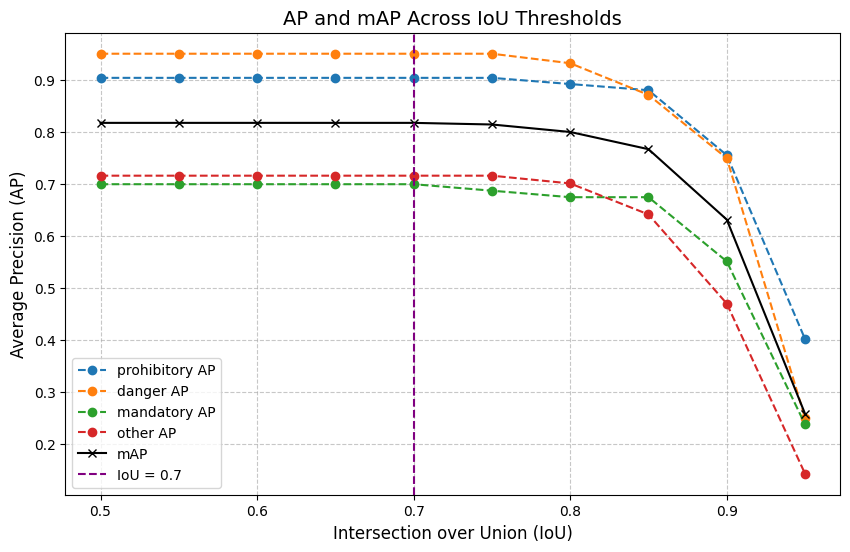

In [109]:
plot_map_results(map_results)

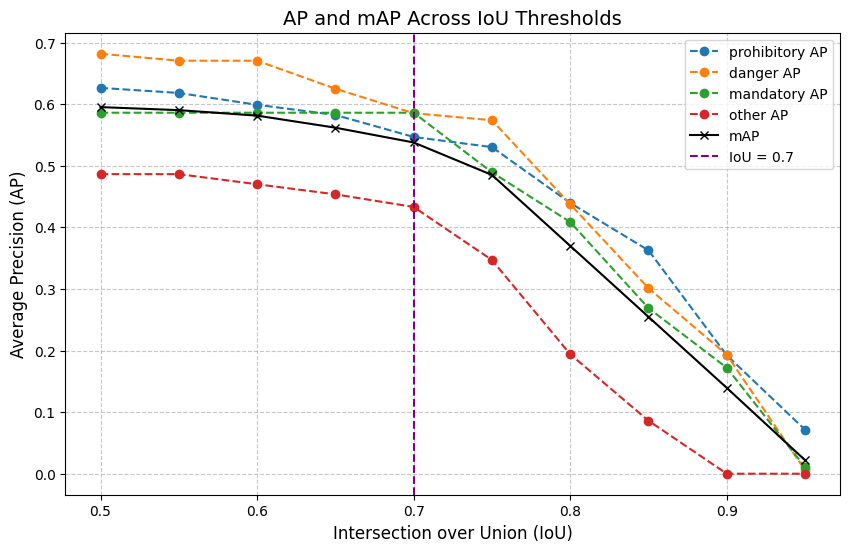

In [110]:
plot_map_results(result)

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import random

def plot_bounding_boxes(images, predictions, targets, class_names=None):
    for img, pred, target in zip(images, predictions, targets):
        img = img.permute(1, 2, 0).cpu().numpy()  
        
        fig, ax = plt.subplots(1, figsize=(10, 10))
        ax.imshow(img)
        
        # Plot predicted bounding boxes
        for box, label, score in zip(pred['boxes'], pred['labels'], pred['scores']):
            box = box.cpu().numpy()
            label = label.item()
            score = score.item()
            color = (random.random(), random.random(), random.random())  
            rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1], 
                                      linewidth=2, edgecolor=color, facecolor='none')
            ax.add_patch(rect)
            if class_names:
                label_name = class_names[label-1]
            else:
                label_name = f'Class {label}'
            ax.text(box[0], box[1] - 10, f'{label_name} {score:.2f}', 
                    color=color, fontsize=12, backgroundcolor='white')
        
        # Plot ground truth bounding boxes
        for box, label in zip(target['boxes'], target['labels']):
            box = box.cpu().numpy()
            label = label.item()
            color = 'green'  
            rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1], 
                                      linewidth=2, edgecolor=color, facecolor='none', linestyle='dashed')
            ax.add_patch(rect)
            if class_names:
                label_name = class_names[label-1]
            else:
                label_name = f'Class {label}'
            ax.text(box[0], box[1] - 10, f'{label_name} (GT)', 
                    color=color, fontsize=12, backgroundcolor='white')
        
        plt.show()
        break  
    
def predict_on_model_and_plot(model, loader):
    res = {}
    model.eval()
    with torch.no_grad():
        for images, targets in val_loader:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            outputs = model(images)
            for output, target in zip(outputs, targets):
                pred_boxes = output['boxes']
                pred_scores = output['scores']
                pred_labels = output['labels']
                target_boxes = target['boxes']
                target_labels = target['labels']

            images = [img.cpu() for img in images]
            plot_bounding_boxes(images, predictions=outputs, targets=targets, class_names=[CLASS_TO_CATEGORY[1], 
                                                                                           CLASS_TO_CATEGORY[2], 
                                                                                           CLASS_TO_CATEGORY[3], 
                                                                                           CLASS_TO_CATEGORY[4]])

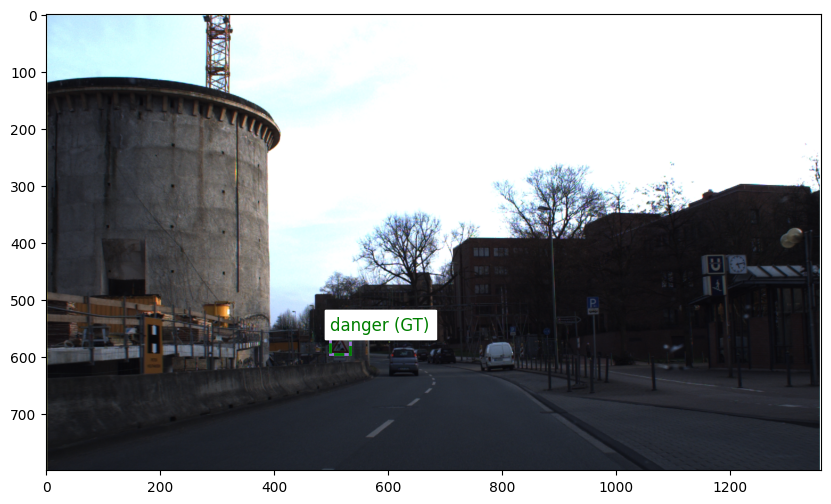

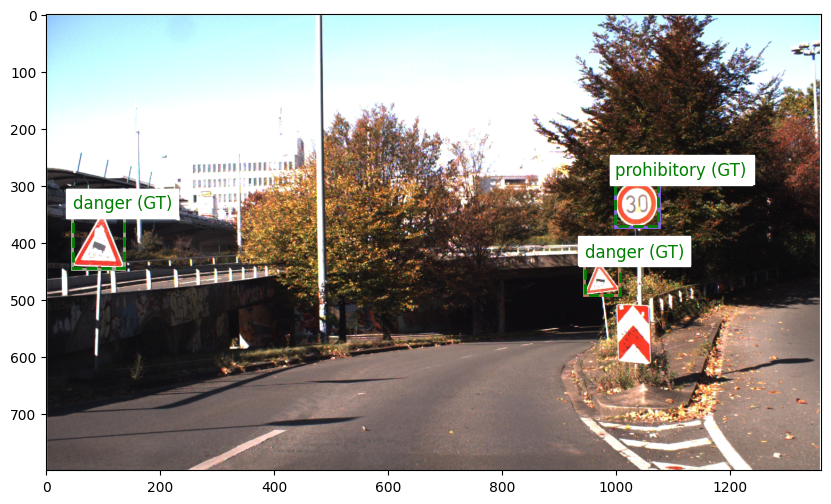

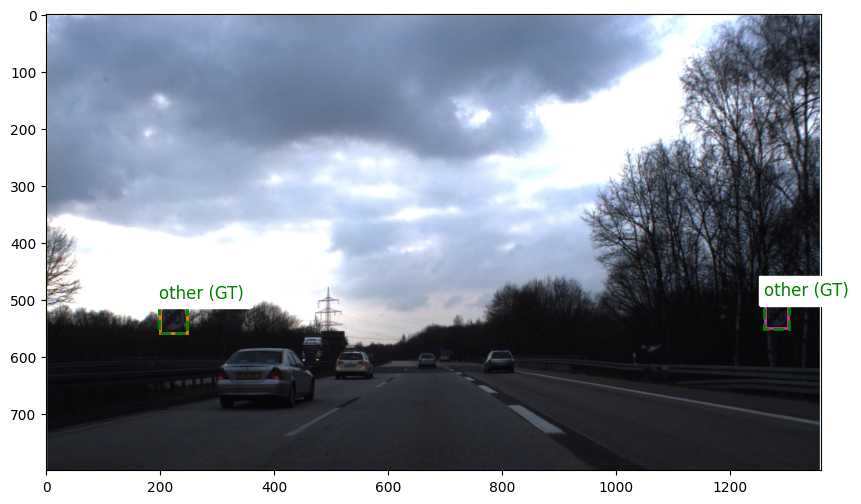

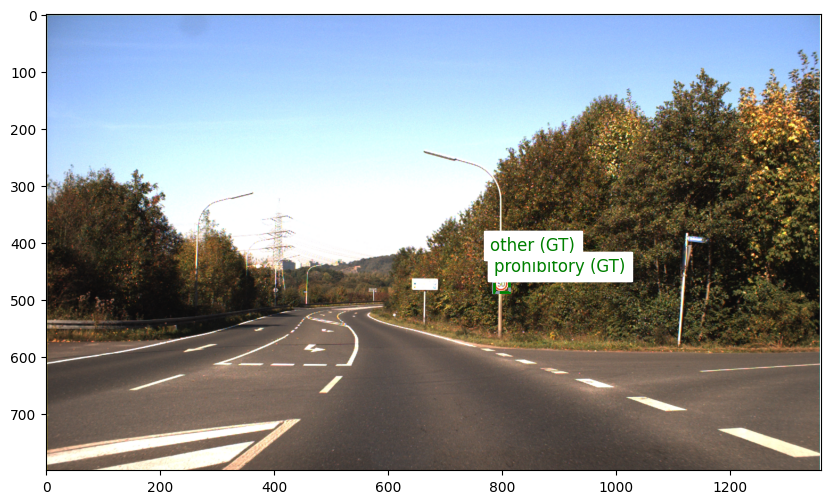

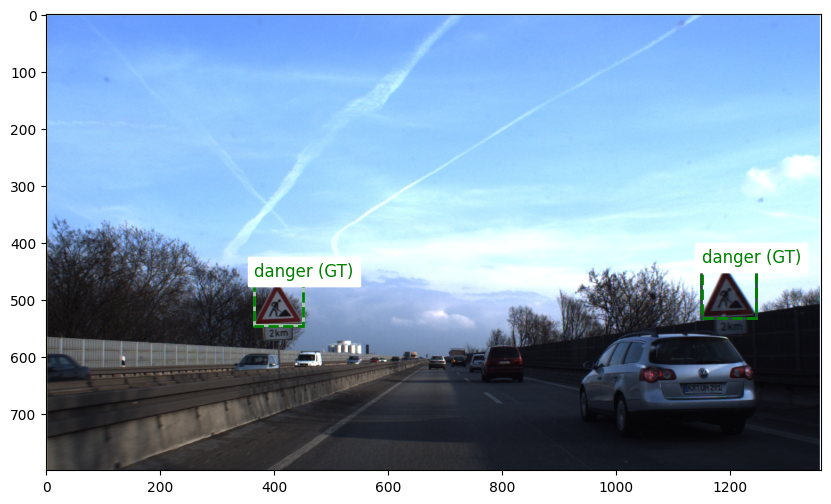

...

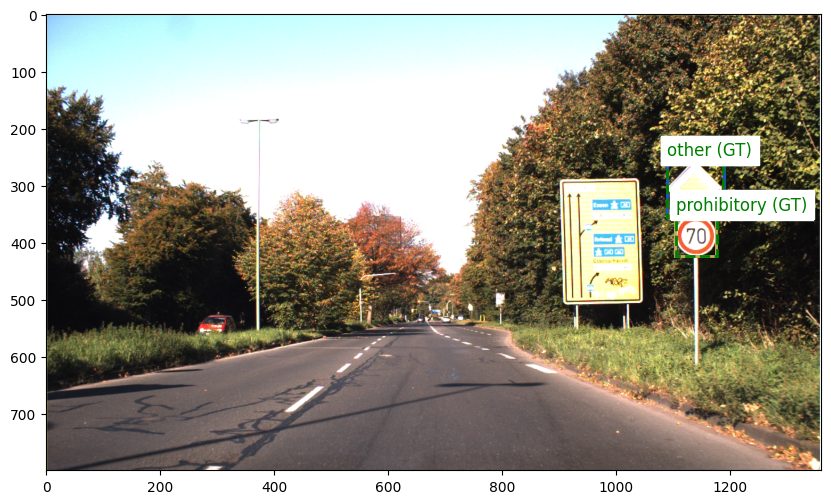

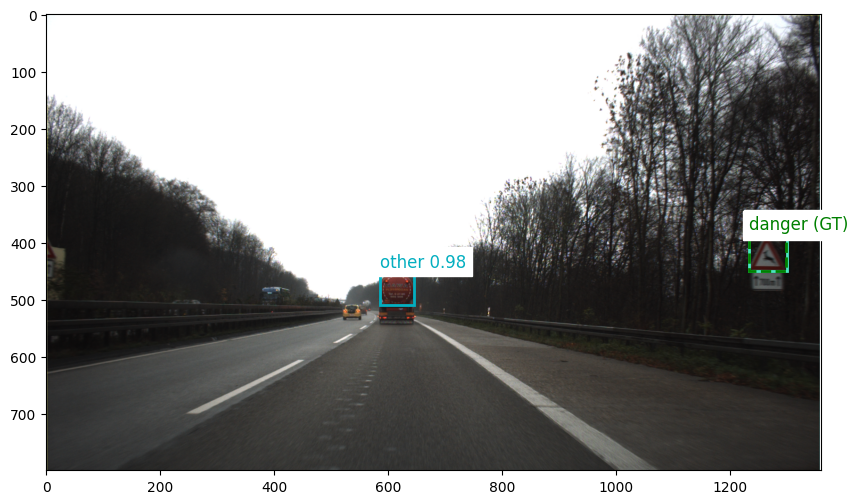

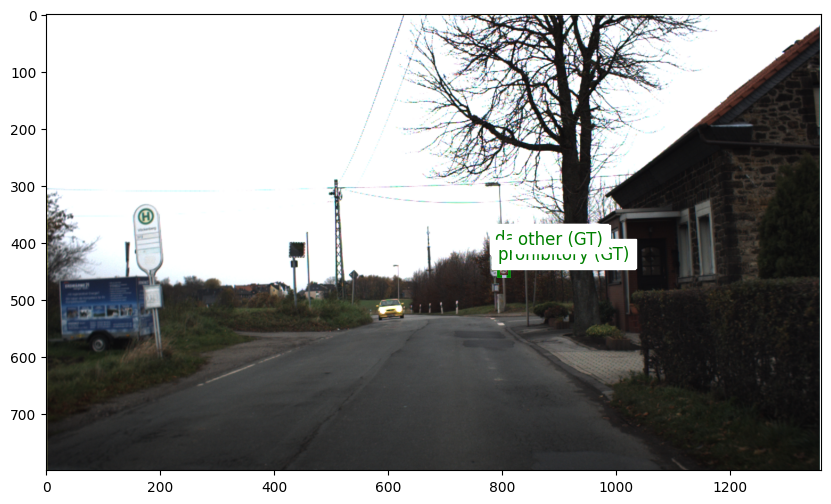

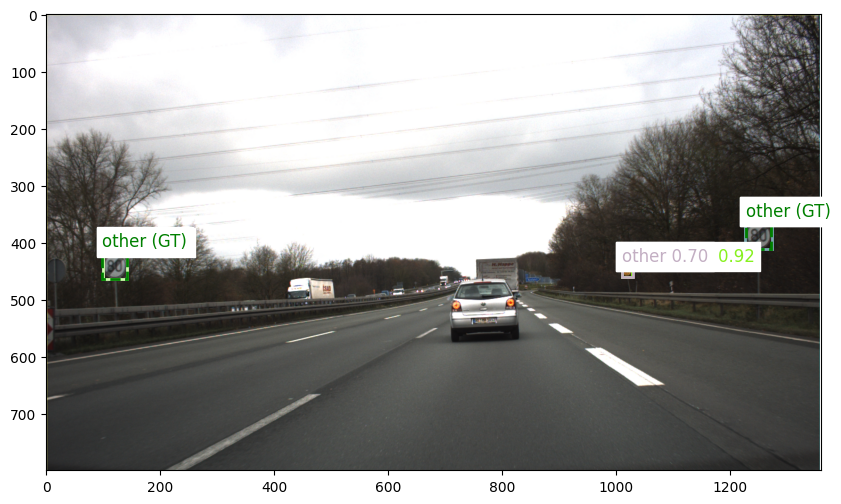

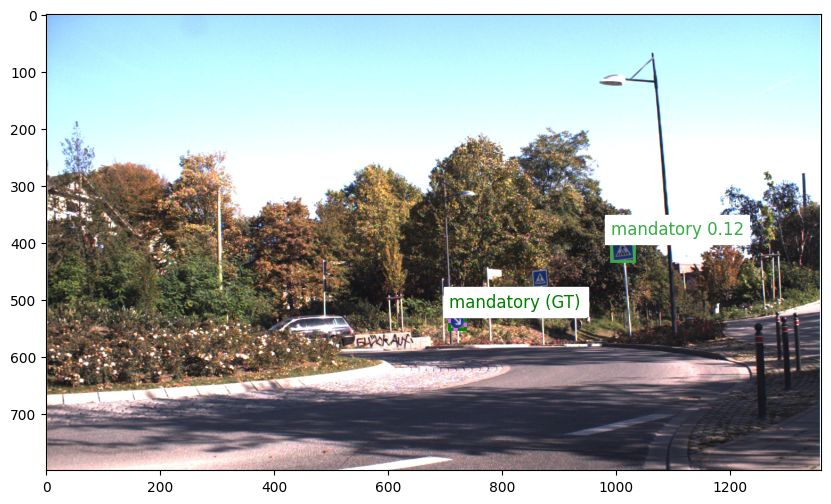

In [80]:
predict_on_model_and_plot(model, test_loader)

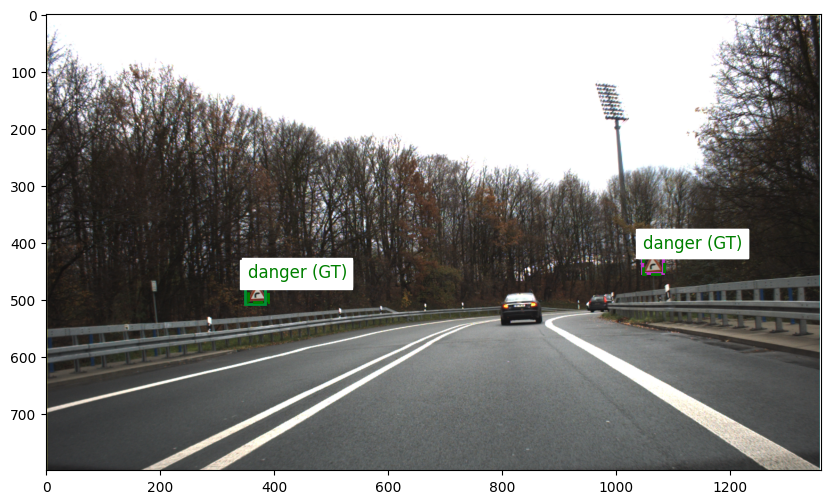

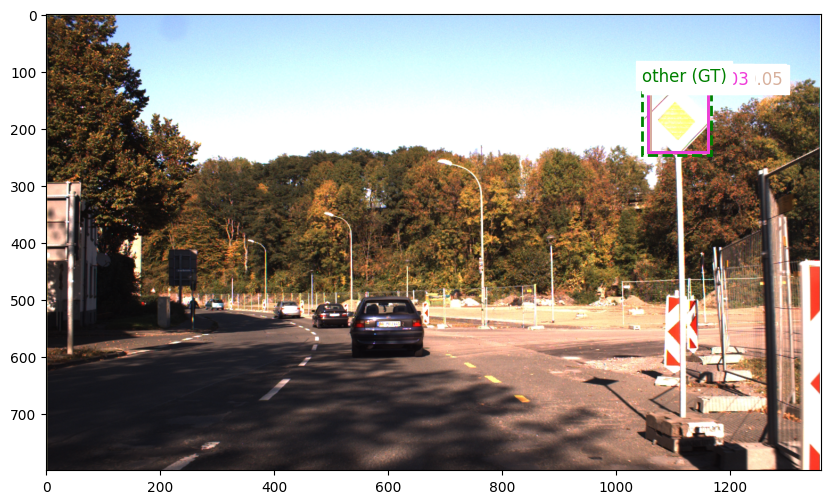

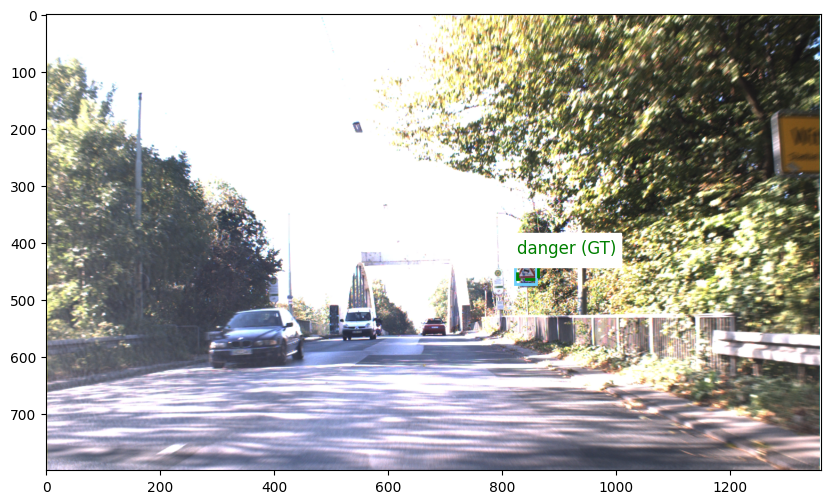

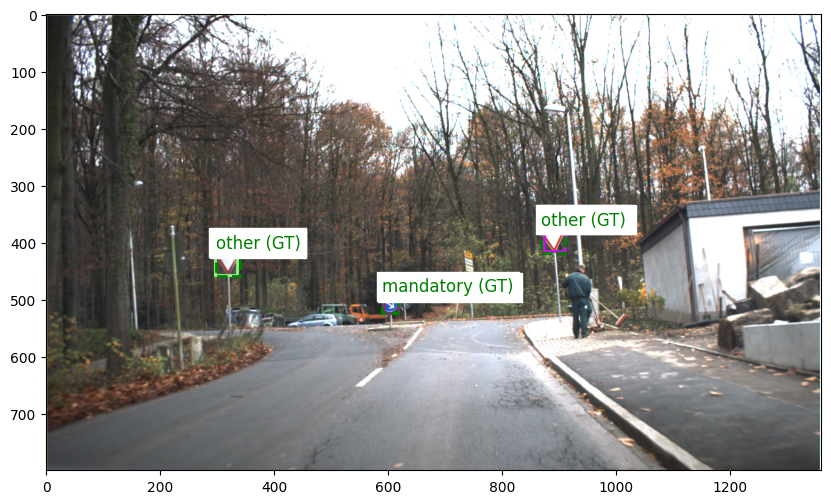

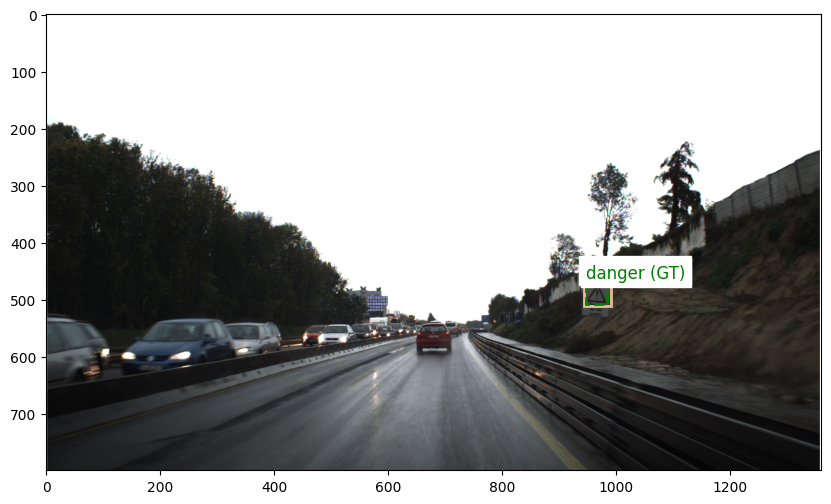

...

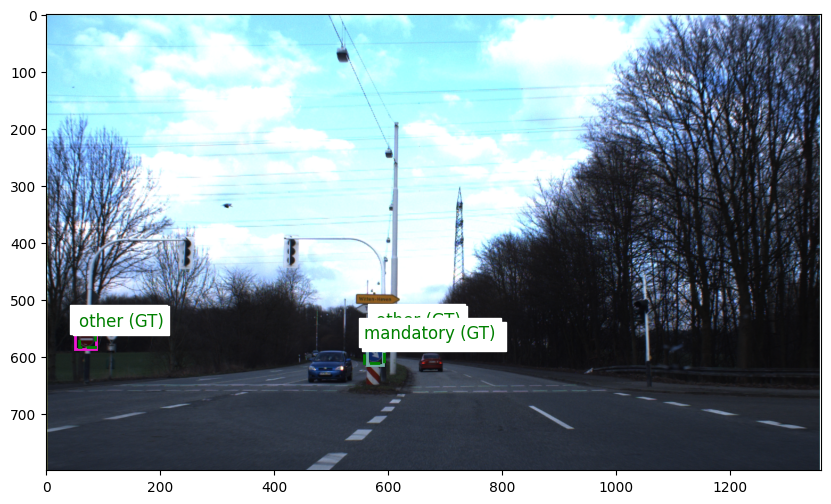

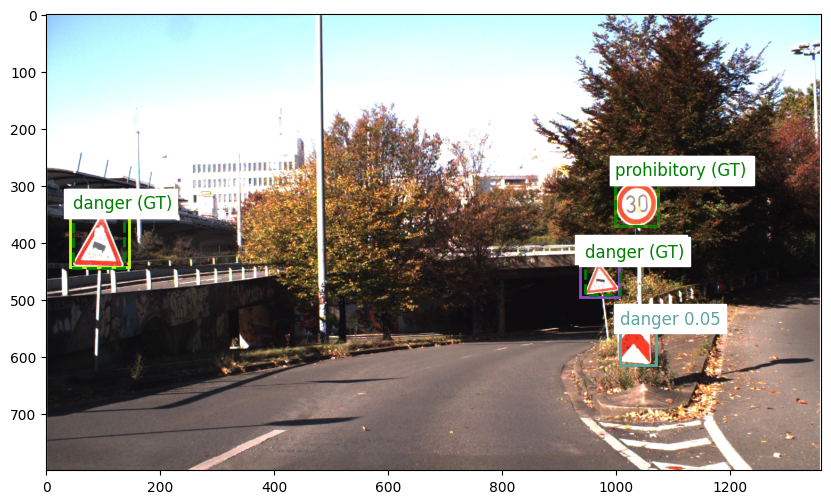

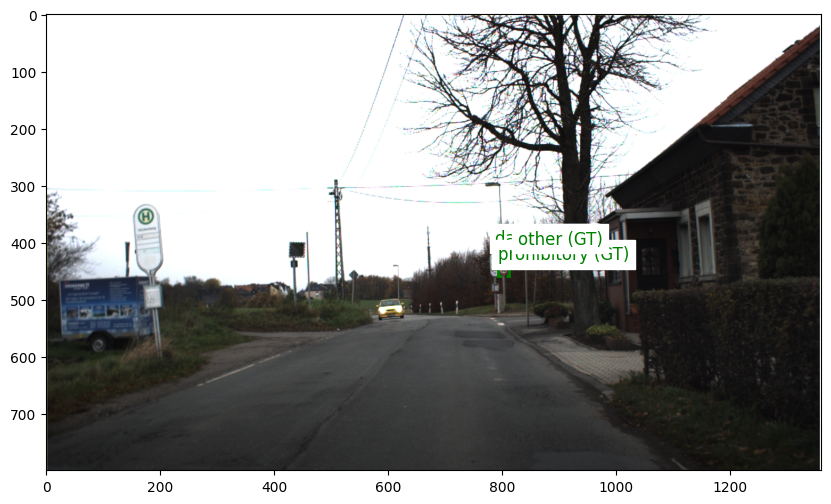

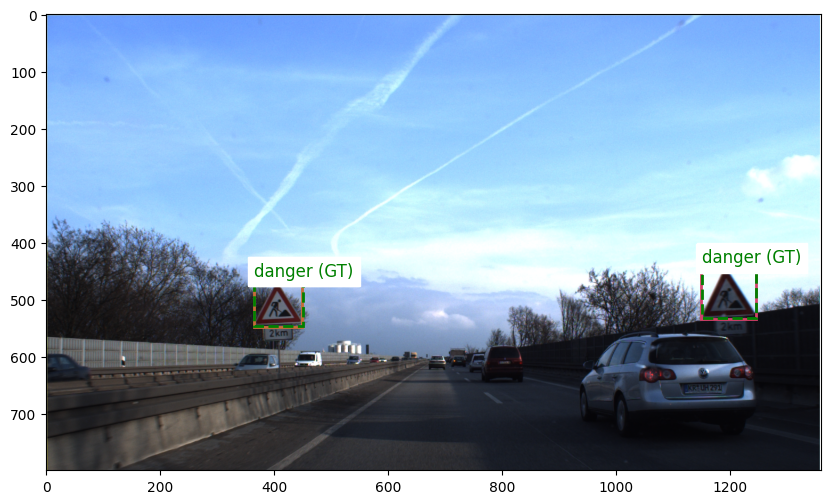

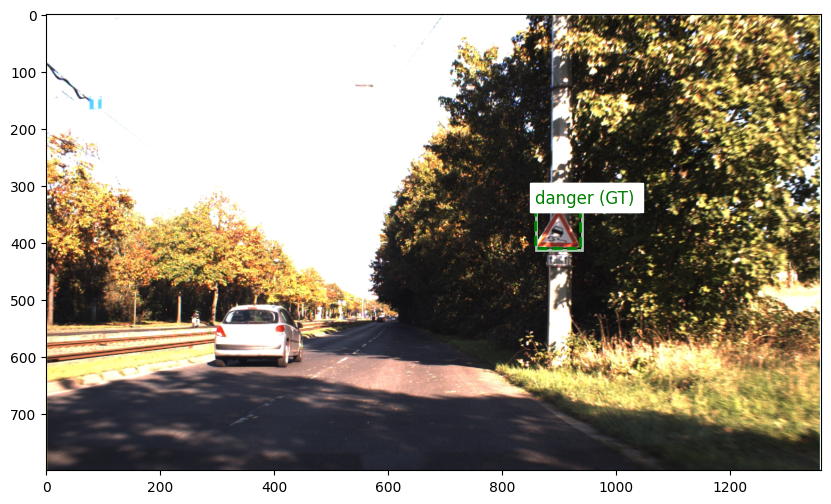

In [81]:
predict_on_model_and_plot(ssd_model, ssd_test_loader)

In [94]:
import torch
import matplotlib.pyplot as plt

def calculate_iou(box, boxes):
    x1 = torch.max(box[0], boxes[:, 0])
    y1 = torch.max(box[1], boxes[:, 1])
    x2 = torch.min(box[2], boxes[:, 2])
    y2 = torch.min(box[3], boxes[:, 3])

    inter_area = torch.clamp(x2 - x1, min=0) * torch.clamp(y2 - y1, min=0)
    box_area = (box[2] - box[0]) * (box[3] - box[1])
    boxes_area = (boxes[:, 2] - boxes[:, 0]) * (boxes[:, 3] - boxes[:, 1])

    union_area = box_area + boxes_area - inter_area
    return inter_area / (union_area + 1e-6)

def get_ap_of(detections, ground_truths, iou_threshold=0.5):
    if not detections or not ground_truths: return 0.0

    detections = torch.tensor(detections, device=device)
    ground_truths = torch.tensor(ground_truths, device=device)
    detections = detections[detections[:, 4].argsort(descending=True)]

    true_positives = torch.zeros(len(detections), device=device)
    false_positives = torch.zeros(len(detections), device=device)
    assigned_gt = torch.zeros(len(ground_truths), dtype=torch.bool, device=device)

    for i, det in enumerate(detections):
        ious = calculate_iou(det[:4], ground_truths)
        max_iou, max_idx = ious.max(0)

        if max_iou >= iou_threshold and not assigned_gt[max_idx]:
            true_positives[i] = 1
            assigned_gt[max_idx] = True
        else:
            false_positives[i] = 1

    # Compute precision and recall
    cum_tp = torch.cumsum(true_positives, dim=0)
    cum_fp = torch.cumsum(false_positives, dim=0)
    precision = cum_tp / (cum_tp + cum_fp + 1e-6)
    recall = cum_tp / len(ground_truths)

    return torch.trapz(precision, recall).item()

def plot_second_paper_image(model, data_loader, sizes=['small', 'medium', 'large'], colors=['blue', 'orange', 'green']):
    model.eval()
    metric_container = {size: {'mAP': 0} for size in sizes}
    results = {size: [] for size in metric_container}
    ground_truths = {size: [] for size in metric_container}

    with torch.no_grad():
        for images, targets in data_loader:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            outputs = model(images)

            for target, output in zip(targets, outputs):
                for box, score in zip(output["boxes"], output["scores"]):
                    size_group = get_size_group(box[2] - box[0])
                    results[size_group].append([*box.tolist(), score.item()])

                for true_box in target["boxes"]:
                    size_group = get_size_group(true_box[2] - true_box[0])
                    ground_truths[size_group].append(true_box.tolist())

    for size in metric_container:
        print(size)
        detections = results[size]
        print(type(size))
        ground_truths = ground_truths[size]
        print('done')
        if detections and ground_truths:
            metric_container[size]['mAP'] = get_ap_of(detections, ground_truths, iou_threshold=0.5)

    # Plotting
    sizes = list(metric_container.keys())
    mAPs = [metric_container[size]['mAP'] for size in sizes]

    plt.figure(figsize=(10, 6))
    plt.bar(sizes, mAPs, color=colors)
    plt.xlabel('Object Size')
    plt.ylabel('mAP')
    plt.title('Model Evaluation (mAP) for Different Object Sizes')
    plt.show()

In [ ]:
def plot_second_paper_image(model, data_loader, sizes=['small', 'medium', 'large'], colors=['blue', 'orange', 'green']):
    model.eval()
    metric_container = {size: {'mAP': 0} for size in sizes}
    results = {size: [] for size in sizes}
    gt_by_size = {size: [] for size in sizes}  

    with torch.no_grad():
        for images, targets in data_loader:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            outputs = model(images)

            for target, output in zip(targets, outputs):
                for box, score in zip(output["boxes"], output["scores"]):
                    size_group = get_size_group(box[2] - box[0])
                    results[size_group].append([*box.tolist(), score.item()])

                for true_box in target["boxes"]:
                    size_group = get_size_group(true_box[2] - true_box[0])
                    gt_by_size[size_group].append(true_box.tolist())

    for size in metric_container:
        detections = results[size]
        ground_truths = gt_by_size[size]  
        if detections and ground_truths:
            metric_container[size]['mAP'] = get_ap_of(detections, ground_truths, iou_threshold=0.5)

    # Plotting
    sizes = list(metric_container.keys())
    mAPs = [metric_container[size]['mAP'] for size in sizes]

    plt.figure(figsize=(10, 6))
    plt.bar(sizes, mAPs, color=colors)
    plt.xlabel('Object Size')
    plt.ylabel('mAP')
    plt.title('Model Evaluation (mAP) for Different Object Sizes')
    plt.show()


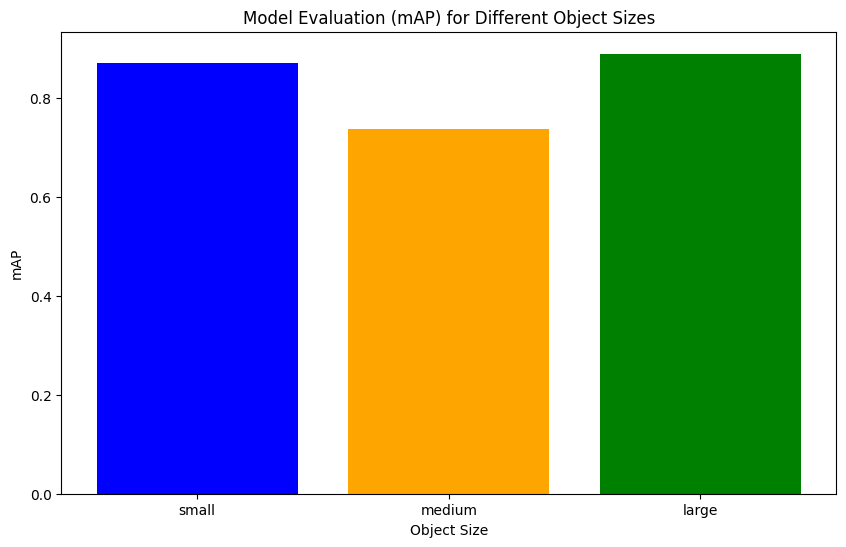

In [97]:
plot_second_paper_image(model, test_loader)

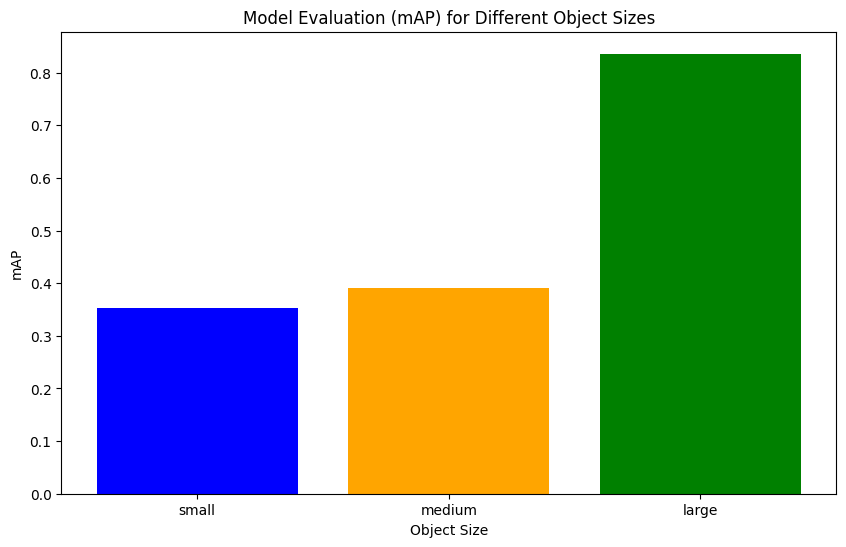

In [98]:
plot_second_paper_image(ssd_model, ssd_test_loader)

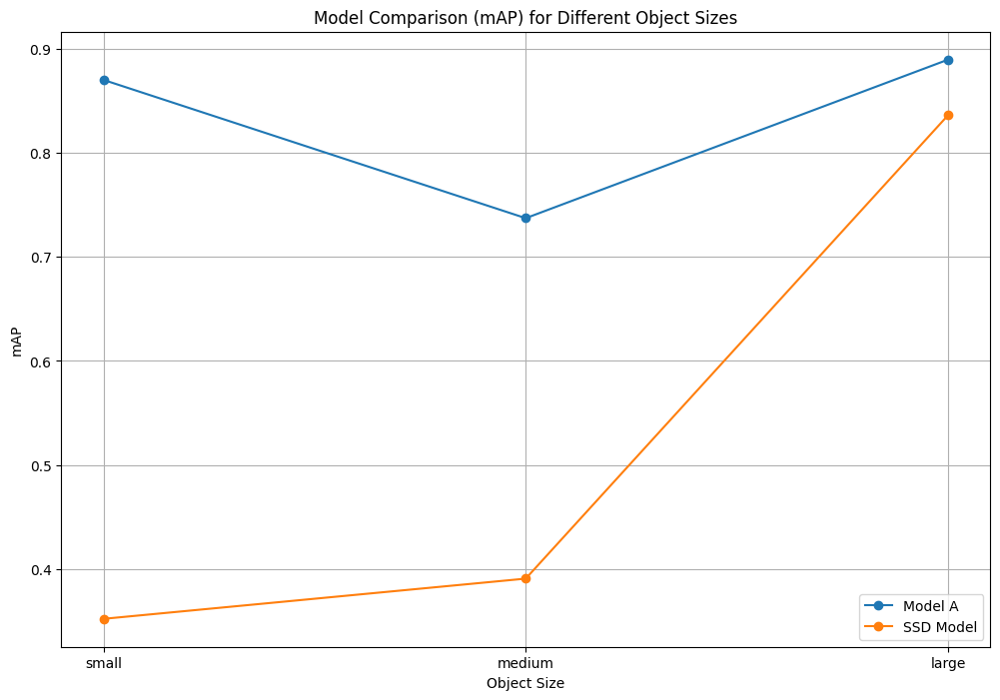

In [ ]:
def plot_comparison(models, data_loaders, model_names, sizes=['small', 'medium', 'large'], colors=None):
    if colors is None:
        colors = plt.cm.tab10.colors[:len(models)]
    
    results = {model_name: {size: 0 for size in sizes} for model_name in model_names}

    for model, data_loader, model_name in zip(models, data_loaders, model_names):
        model.eval()
        metric_container = {size: {'mAP': 0} for size in sizes}
        results_by_size = {size: [] for size in sizes}
        ground_truths_by_size = {size: [] for size in sizes}

        with torch.no_grad():
            for images, targets in data_loader:
                images = [img.to(device) for img in images]
                targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
                outputs = model(images)

                for target, output in zip(targets, outputs):
                    for box, score in zip(output["boxes"], output["scores"]):
                        size_group = get_size_group(box[2] - box[0])
                        results_by_size[size_group].append([*box.tolist(), score.item()])

                    for true_box in target["boxes"]:
                        size_group = get_size_group(true_box[2] - true_box[0])
                        ground_truths_by_size[size_group].append(true_box.tolist())

        for size in metric_container:
            detections = results_by_size[size]
            ground_truths = ground_truths_by_size[size]
            if detections and ground_truths:
                metric_container[size]['mAP'] = get_ap_of(detections, ground_truths, iou_threshold=0.5)
            results[model_name][size] = metric_container[size]['mAP']

    # Plotting
    x = range(len(sizes))
    plt.figure(figsize=(12, 8))

    for idx, model_name in enumerate(model_names):
        mAPs = [results[model_name][size] for size in sizes]
        plt.plot(x, mAPs, label=model_name, marker='o', color=colors[idx])

    plt.xticks(x, sizes)
    plt.xlabel('Object Size')
    plt.ylabel('mAP')
    plt.title('Model Comparison (mAP) for Different Object Sizes')
    plt.legend()
    plt.grid(True)
    plt.show()


models = [model, ssd_model]
data_loaders = [test_loader, ssd_test_loader]
model_names = ['Model A', 'SSD Model']

plot_comparison(models, data_loaders, model_names)


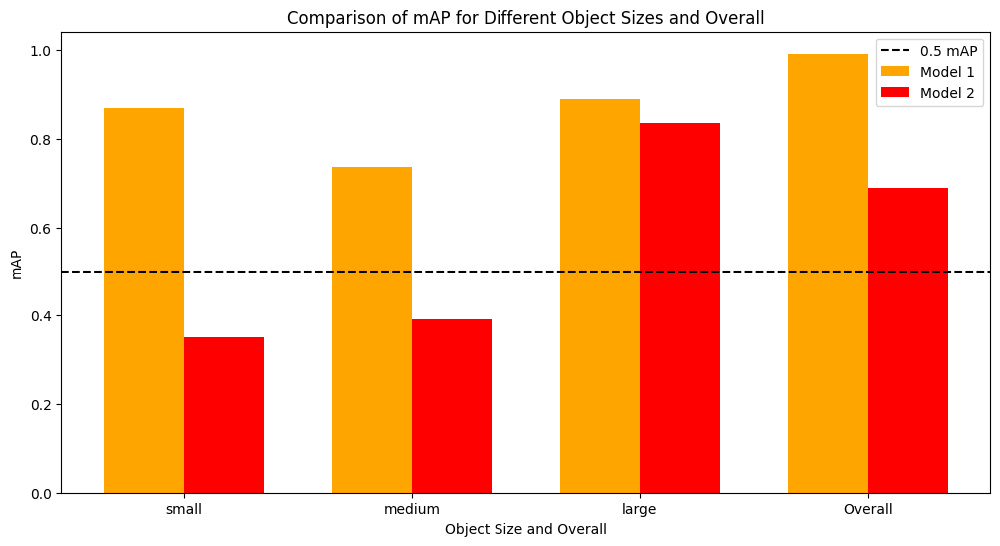

In [ ]:
def plot_comparison_with_overall(model1, loader1, model2, loader2, sizes=['small', 'medium', 'large'], colors1=['orange', 'orange', 'orange'], colors2=['red', 'red', 'red']):
    def calculate_metrics(model, loader, sizes):
        model.eval()
        results = {size: [] for size in sizes}
        gt_by_size = {size: [] for size in sizes}
        metric_container = {size: {'mAP': 0} for size in sizes}

        with torch.no_grad():
            for images, targets in loader:
                images = [img.to(device) for img in images]
                targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
                outputs = model(images)

                for target, output in zip(targets, outputs):
                    for box, score in zip(output["boxes"], output["scores"]):
                        size_group = get_size_group(box[2] - box[0])
                        results[size_group].append([*box.tolist(), score.item()])

                    for true_box in target["boxes"]:
                        size_group = get_size_group(true_box[2] - true_box[0])
                        gt_by_size[size_group].append(true_box.tolist())

        for size in sizes:
            detections = results[size]
            ground_truths = gt_by_size[size]
            if detections and ground_truths:
                metric_container[size]['mAP'] = get_ap_of(detections, ground_truths, iou_threshold=0.5)

        # Compute overall mAP
        all_detections = sum(results.values(), [])
        all_ground_truths = sum(gt_by_size.values(), [])
        overall_mAP = get_ap_of(all_detections, all_ground_truths, iou_threshold=0.5) if all_detections and all_ground_truths else 0.0

        mAPs = [metric_container[size]['mAP'] for size in sizes]
        mAPs.append(overall_mAP)  # Add overall mAP
        return mAPs

    mAPs_model1 = calculate_metrics(model1, loader1, sizes)
    mAPs_model2 = calculate_metrics(model2, loader2, sizes)

    # Plotting
    x = range(len(sizes) + 1)  
    bar_width = 0.35
    categories = sizes + ['Overall']

    plt.figure(figsize=(12, 6))
    plt.bar([i - bar_width / 2 for i in x], mAPs_model1, bar_width, color=colors1, label='Model 1')
    plt.bar([i + bar_width / 2 for i in x], mAPs_model2, bar_width, color=colors2, label='Model 2')

    # Add horizontal line at y = 0.5
    plt.axhline(y=0.5, color='black', linestyle='--', label='0.5 mAP')

    plt.xticks(x, categories)
    plt.xlabel('Object Size and Overall')
    plt.ylabel('mAP')
    plt.title('Comparison of mAP for Different Object Sizes and Overall')
    plt.legend()
    plt.show()

plot_comparison_with_overall(model, test_loader, ssd_model, ssd_test_loader)